# Problem Statement


Atopic dermatitis (AD), also called atopic eczema, is a common chronic or recurrent inflammatory skin disease and affects 15-20% of children and 1-3% of adults worldwide. It is characterized by acute flare-ups of eczematous pruritic lesions over dry skin.
https://www.karger.com/Article/FullText/370220#:~:text=Introduction,pruritic%20lesions%20over%20dry%20skin.

Eczema can affect an individual's quality of life. It increases the chances of it being more manageable when appropriate interventions and treatments are made when diagnosed early. However, eczema symptoms can be similar to other rashes and itch. By creating a classification model to classify for eczema and sort out from other skin diseases, it will help individuals to self-diagnose and sort appropriate timely medical treatment. 

# Abstract

Skin images are downloaded from a Kaggle dataset (link at end of abstract). Images are manually sorted out to create several datasets:

a) dataset consisting of eczema and non-eczema images of feet (378 images)

b) dataset consisting of eczema images of feet (120 images)

c) 1st dataset consisting of eczema and non-eczema images from various parts of the body (3127 images)

d) 2nd dataset consisting of eczema and non-eczema images from various parts of the body (774 images)

**Non-eczema images for a) are images of feet with tinea (fungal infection).**
**Non-eczema images for c) and d) are images of feet with from other skin diseases such as pityriasis (skin rash) and psoriasis.

For a), it is split into training and validation data. b) is not splitted. For c), it is split into training and validation data. d) is not splitted. The training data is used to train the model and validation data is used to validate the model. 

A standard Convolutional Neural Network (CNN) is built from scratch is trained with a) to classify eczema and non-eczema images of feet. The validation accuracy score is around 75%. b) is used as a test dataset to evaluate if the CNN trained on feet images is able to classify eczema and non-eczema images from other body parts. The CNN is unable to classify eczema and non-eczema images from other body parts when trained on feet images only; the accuracy score is around 55%.

Next, a CNN is built from scratch is trained with c) to classify eczema and non-eczema images from various parts of the body. d) is used as the test data to evaluate the performance of the model. The CNN is not performing well; the accuracy score is around 59%. 

After that, the MobileNet V2 is incorperated into the CNN as a base model to try improve the accuracy. d) is used as the test dataset to obtain the test accuracy score. CNN without fine tuning of base model achieved test accuracy of 68%. CNN with top 25 layers of the base model fine tuned achieved 73% test score and CNN with top 55 layers fine tuned achieved 77% test score. There is an incremental increase from 73% to 77% when the number of top layers in the base model to fine tune is increased. 

The model has a modest accuracy 77% to classify eczema from noneczema images rom various parts of the body. Future work can be done to fine tune the model and deploy it.

# Import Libraries

In [1]:
# import tensorflow
import tensorflow as tf

# numpy for math functions etc
import numpy as np

# random from python core
import random as rnd

# import keras
from tensorflow import keras
from tensorflow.keras import layers

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# neural network libraries
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras import models

# Conv2D and MaxPooling for cnn
from tensorflow.keras.layers import Conv2D, MaxPooling2D

# utilities
from tensorflow.keras import utils

# for loading in image as a dataframe from directory
from tensorflow.keras.preprocessing import image_dataset_from_directory

# PILLOW; python imaging library
import PIL.Image

# PIL image filter method
from PIL.ImageFilter import (
   BLUR, CONTOUR, DETAIL, EDGE_ENHANCE, EDGE_ENHANCE_MORE,
   EMBOSS, FIND_EDGES, SMOOTH, SMOOTH_MORE, SHARPEN)

# plotting graphs
from matplotlib import pyplot as plt

# path library
from pathlib import Path as path

# layer visualization library
import keract
from keract import get_activations
from keract import display_activations




# Path to picture folders

In [20]:
# path to compiled photos folder (adfeet + eczema)
compiled = path("C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/feet/compile")

# path to pictures (unseen folder)
unseen = path("C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/feet/Unseen")

- In the compiled folder, it contains only pictures of feet that is categorized into Eczema and non-Eczema. Non-eczema images are images of feet with tinea (fungal infection).
- In the unseen folder, it contains pictures of Eczema from various body parts like face, hands etc.

## List the jpg files in the compiled folder

In [3]:
# list all the files in compiled
lst_compiled = list(compiled.glob('**/*.jpg'))

# shows the first file in the folder
lst_compiled[0]

WindowsPath('C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/feet/compile/Eczema/05Atopic042801.jpg')

## Filter for files in a folder

In [4]:
# filter for a specific file
[lst_compiled.index(a) for a in lst_compiled  if 'eczema-foot-1' in str(a)]

[72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82]

In [5]:
# show file 72
lst_compiled[72]

WindowsPath('C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/feet/compile/Eczema/eczema-foot-1.jpg')

# Open an image using Python Imaging Library

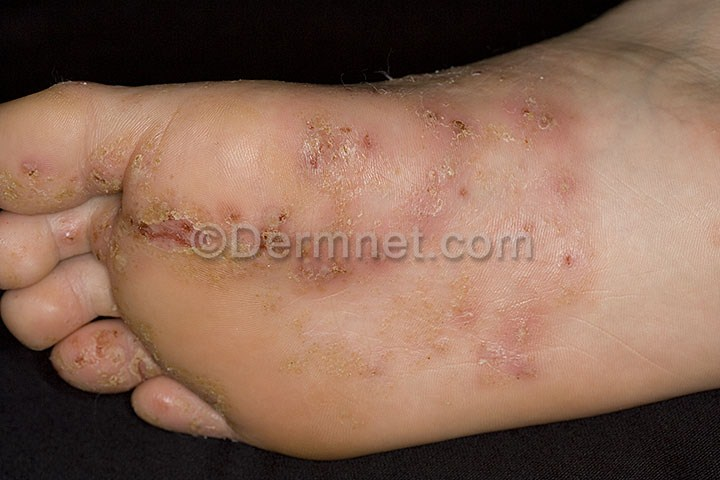

In [6]:
# display an image to see how is it like
PIL.Image.open(lst_compiled[72])

# Create fixed dataset from compiled (train dataset)

## Check that the `image_dataset_from_directory` function is splitting the files properly and there is no data leakage
- First, I will do a quick check to make sure the function to create the tensorflow datasets is working as intended.

In [7]:
# path to verify folder to verify image_dataset_from_directory function
verify = path("C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/verify_function")

In [8]:
# 36 files in verify
lst_verify = list(verify.glob('**/*.jpg'))
print(len(lst_verify))

36


- There are 36 files in verify.

In [9]:
# split out 70% of the data from verify to be designated as training data
batch_size = 32
img_height = 480
img_width = 480


verify_trainds = image_dataset_from_directory(
  verify,
  label_mode = 'int',
  validation_split=0.3,
  subset="training",
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 36 files belonging to 1 classes.
Using 26 files for training.


In [10]:
# split out 70% of the data from verify to be designated as validation data
batch_size = 32
img_height = 480
img_width = 480


verify_valds = image_dataset_from_directory(
  verify,
  label_mode = 'int',
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 36 files belonging to 1 classes.
Using 10 files for validation.


In [11]:
# show the number of files in each batch in training data split from verify
counter = 1

for image_batch, labels_batch in verify_trainds:
    print(counter, image_batch.shape)
    print(counter, labels_batch.shape)
    counter += 1

1 (26, 480, 480, 3)
1 (26,)


- There are 26 image files, 480 x 480, RGB in 1 batch for the training data.

In [12]:
# show the number of files in each batch in validation data split from verify
counter = 1

for image_batch, labels_batch in verify_valds:
    print(counter, image_batch.shape)
    print(counter, labels_batch.shape)
    counter += 1

1 (10, 480, 480, 3)
1 (10,)


- There are 10 image files, 480 x 480, RGB in 1 batch for the validation data.

### Check the images split by the function

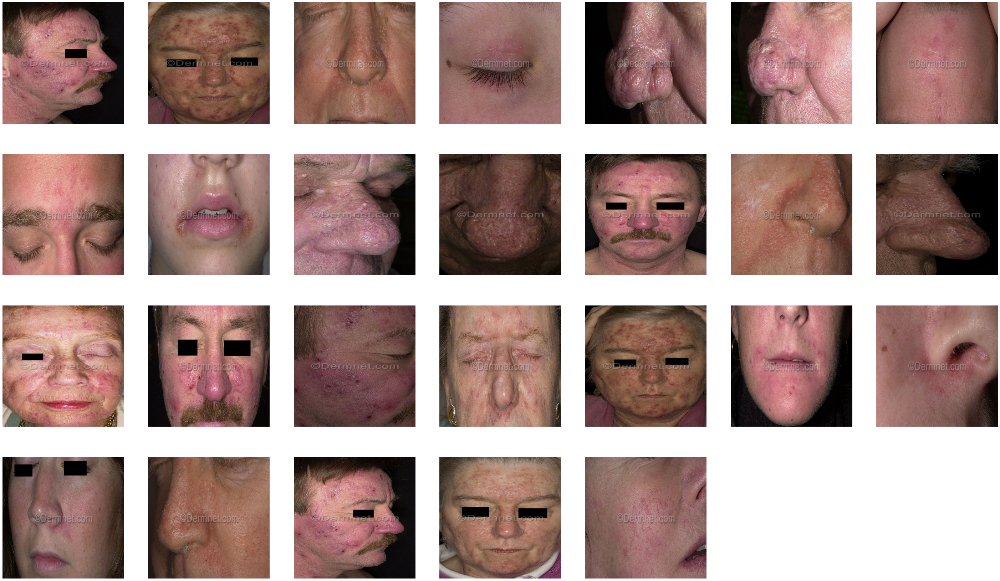

In [13]:
#images in train

for image, label in verify_trainds:
    plt.figure(figsize=(50, 30))
    
    for i in range(26):
        ax = plt.subplot(4, 7, i + 1)
        plt.imshow(image[i].numpy().astype("uint8"))
        plt.axis("off")

- Above are the images in the training data split from verify.

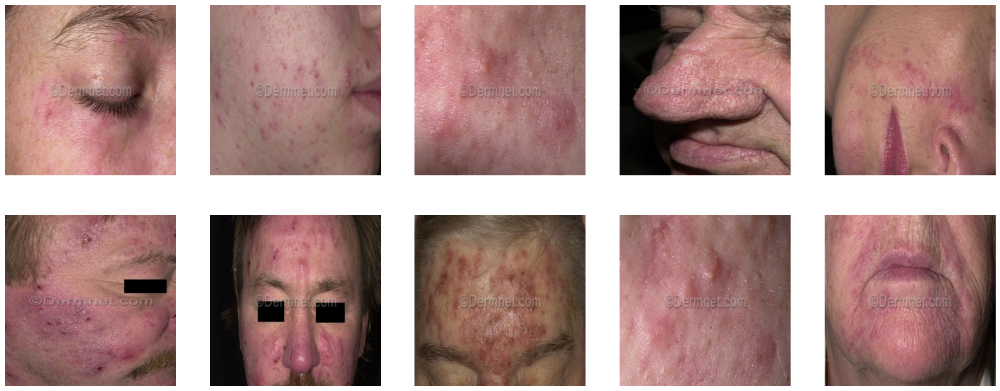

In [14]:
#images in val

for image, label in verify_valds:

    plt.figure(figsize=(25, 10))
    for i in range(10):
        ax = plt.subplot(2, 5, i + 1)
        plt.imshow(image[i].numpy().astype("uint8"))
        plt.axis("off")

- Above are the images in the validation data split from verify.

**There are no overlapping or repeated images. The images in the training data split from verify (verify_trainds) and the images in the validation data split from verify (verify_valds) are mutually exclusive.**

## Create training data and validation data from `compiled`

- I will create fixed dataset from the compiled folder below.
- Train dataset is split into training data and validate data.
- Out of the 378 files, 303 is used as training data and 75 is used as validate data.

In [15]:
# training data
# split out training data from train dataset
batch_size = 32
img_height = 480
img_width = 480


train_ds = image_dataset_from_directory(
  compiled,
  validation_split=0.2,   # reserve 20% of data for validation
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  subset="training",             
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 378 files belonging to 2 classes.
Using 303 files for training.


In [16]:
# validation data
# split out validation data from train dataset
batch_size = 32
img_height = 480
img_width = 480


val_ds = image_dataset_from_directory(
  compiled,
  validation_split=0.2,
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  subset="validation",           
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 378 files belonging to 2 classes.
Using 75 files for validation.


In [17]:
images, labels = next(iter(train_ds))

**image_dataset_from_directory creates tensorflow dataset objects and returns the following when images, labels iterates through the dataset:**

- `images` has shape (batch_size, image_size[0], image_size[1], num_channels).
- images are split into batches, each batch = 32 by default.
- `labels` returns the label for each picture.
- the label for each picture is assigned according to the classification of the pictures in the folder initially. Here, there are only 2 classes hence there are only 2 labels.

- .numpy() can be used to call on the image_batch and labels_batch tensors to convert them to a numpy.ndarray

In [18]:
images.shape

TensorShape([32, 480, 480, 3])

- 32 =  batch_size
- 480 = image_size[0]; referring to the number of rows of pixels, defined as 480 when creating tensorflow data
- 480 = image_size[1]; referring to the number of columns of pixels, defined as 480 when creating tensorflow data
- 3 = num_channels; it is the number of channels in the picture, defined as red channel, green channel, blue channel (RGB). By default the pictures are defined in RGB.

In [19]:
# converts the tensorflow object into numpy array and show the array for each of the 32 images
images.numpy()

array([[[[  7.25     ,   2.25     ,   6.25     ],
         [ 12.5      ,   7.5      ,  11.5      ],
         [ 10.75     ,   5.75     ,   9.75     ],
         ...,
         [ 15.25     ,   9.25     ,  12.75     ],
         [ 12.25     ,   6.25     ,  10.25     ],
         [ 13.       ,   7.       ,  11.       ]],

        [[  7.98125  ,   2.98125  ,   6.98125  ],
         [ 12.5      ,   7.5      ,  11.5      ],
         [ 10.75     ,   5.75     ,   9.75     ],
         ...,
         [ 15.25     ,   9.25     ,  12.75     ],
         [ 12.25     ,   6.25     ,  10.25     ],
         [ 12.26875  ,   6.26875  ,  10.26875  ]],

        [[  8.71875  ,   3.71875  ,   7.71875  ],
         [ 11.78125  ,   6.78125  ,  10.78125  ],
         [ 10.989583 ,   5.9895835,   9.989583 ],
         ...,
         [ 14.53125  ,   8.53125  ,  12.03125  ],
         [ 13.208334 ,   7.2083335,  11.208334 ],
         [ 11.770833 ,   5.770833 ,   9.770833 ]],

        ...,

        [[ 14.416626 ,   8.416626 ,  1

- The RGB values are from 0 to 255, as the pictures are 8-bit depth pictures.

In [20]:
# converts the tensorflow object into numpy array and show the label for each of the 32 images
labels.numpy()

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0,
       1, 1, 1, 0, 0, 1, 1, 1, 0, 0])

In [21]:
print(f'There are {len(labels)} images.')

There are 32 images.


- Above shows the labels for each picture in the batch
- There are 32 images in the batch because the parameter `batch_size` is set to 32. (batch_size = 32)

In [22]:
counter = 1

for image_batch, labels_batch in train_ds:
    print(counter, image_batch.shape)
    print(counter, labels_batch.shape)
    counter += 1

1 (32, 480, 480, 3)
1 (32,)
2 (32, 480, 480, 3)
2 (32,)
3 (32, 480, 480, 3)
3 (32,)
4 (32, 480, 480, 3)
4 (32,)
5 (32, 480, 480, 3)
5 (32,)
6 (32, 480, 480, 3)
6 (32,)
7 (32, 480, 480, 3)
7 (32,)
8 (32, 480, 480, 3)
8 (32,)
9 (32, 480, 480, 3)
9 (32,)
10 (15, 480, 480, 3)
10 (15,)


In [23]:
print(f'There are a total of {((32*9) + 15)} images, split into 10 batches, the last batch has 15 images.')
print(f'There are a total of {((32*9) + 15)} images, split into 10 batches, the last batch has 15 images. Each of the image are labeled during dataset creation.')

There are a total of 303 images, split into 10 batches, the last batch has 15 images.
There are a total of 303 images, split into 10 batches, the last batch has 15 images. Each of the image are labeled during dataset creation.


- When a loop is run through the tensorflow dataset, it is seen that for the 303 images in the training data, it is split into 10 batches, with 15 images in the 10th batch. As seen earlier, each of the image will be labeled.
- image_batch shows the number of images in each batch.
- labels_batch, contains the labels for each image.

## Check class distribution in the training and validation datasets

In [24]:
counter = 1
class_0 = []
class_1 = []

for image_batch, labels_batch in train_ds:
    for a in labels_batch.numpy():
        if a == 0:
            class_0.append(a)
        else:
            class_1.append(a)
    print(counter, labels_batch.shape)
    print(f'frequency of class 0 is {class_0.count(0)}, frequency of class 1 is {class_1.count(1)}')
    counter += 1

1 (32,)
frequency of class 0 is 24, frequency of class 1 is 8
2 (32,)
frequency of class 0 is 46, frequency of class 1 is 18
3 (32,)
frequency of class 0 is 64, frequency of class 1 is 32
4 (32,)
frequency of class 0 is 79, frequency of class 1 is 49
5 (32,)
frequency of class 0 is 99, frequency of class 1 is 61
6 (32,)
frequency of class 0 is 121, frequency of class 1 is 71
7 (32,)
frequency of class 0 is 134, frequency of class 1 is 90
8 (32,)
frequency of class 0 is 151, frequency of class 1 is 105
9 (32,)
frequency of class 0 is 171, frequency of class 1 is 117
10 (15,)
frequency of class 0 is 182, frequency of class 1 is 121


In [25]:
print(f'Class 0 in train_ds is {train_ds.class_names[0]}, Class 1 in train_ds is {train_ds.class_names[1]}.')
print(f'Percentage of class 0 is {182/303 :.2f}, percentage of class 1 is {121/303 :.2f}.')

Class 0 in train_ds is Eczema, Class 1 in train_ds is non-eczema.
Percentage of class 0 is 0.60, percentage of class 1 is 0.40.


- In the training dataset, there are a total of 303 images. The `image_dataset_from_directory` function splits the number of images for 2 classes to a ratio of 6:4 by default. Hence I will specify the class weights when fitting the train data to the neural networks later to minimize the effect of class imbalance.

In [26]:
counter = 1
class_0 = []
class_1 = []

for image_batch, labels_batch in val_ds:
    for a in labels_batch.numpy():
        if a == 0:
            class_0.append(a)
        else:
            class_1.append(a)
    print(counter, labels_batch.shape)
    print(f'frequency of class 0 is {class_0.count(0)}, frequency of class 1 is {class_1.count(1)}')
    counter += 1

1 (32,)
frequency of class 0 is 16, frequency of class 1 is 16
2 (32,)
frequency of class 0 is 37, frequency of class 1 is 27
3 (11,)
frequency of class 0 is 45, frequency of class 1 is 30


In [27]:
print(f'Class 0 in val_ds is {val_ds.class_names[0]}, Class 1 in val_ds is {val_ds.class_names[1]}.')
print(f'Percentage of class 0 is {45/75 :.2f}, percentage of class 1 is {30/75 :.2f}.')

Class 0 in val_ds is Eczema, Class 1 in val_ds is non-eczema.
Percentage of class 0 is 0.60, percentage of class 1 is 0.40.


- Similarly, in the validation dataset, the number of images for the 2 classes is split to a ratio of 6:4.

## Classes in the training and validate data

In [28]:
# show class names in training data
print(f'Class 0 in train_ds is {train_ds.class_names[0]}, Class 1 in train_ds is {train_ds.class_names[1]}.')
print(f'Class 0 in val_ds is {val_ds.class_names[0]}, Class 1 in val_ds is {val_ds.class_names[1]}.')

Class 0 in train_ds is Eczema, Class 1 in train_ds is non-eczema.
Class 0 in val_ds is Eczema, Class 1 in val_ds is non-eczema.


**Class 0 is Eczema and class 1 is non-eczema in training and validation dataset.**

## Show 9 images in the training data

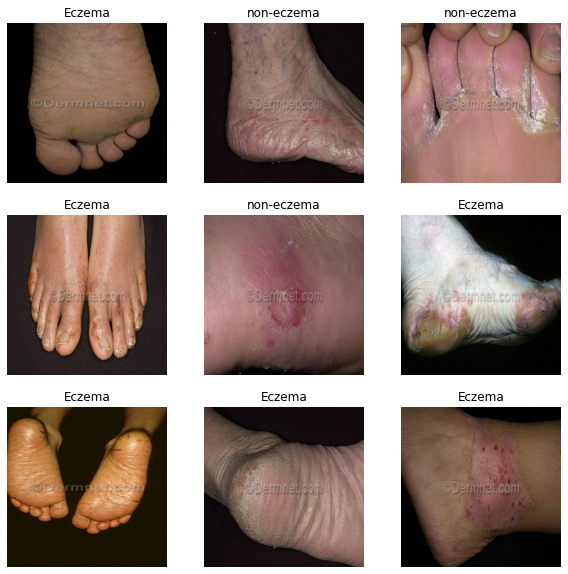

In [29]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(train_ds.class_names[labels[i]])
        plt.axis("off")

## Use PIL to show image properties

In [31]:
# shows what mode is the image in, how many channels
PIL.Image.open(lst_compiled[72]).mode

'RGB'

In [32]:
# shows size of image, how many pixels
PIL.Image.open(lst_compiled[72]).size

(720, 480)

- From the above, we can see that the images are in RGB and each image is 720 by 480 pixels.

# Pre-processing layers in CNN

- Pre-processing layers can be added before the images are flowed into the neural network.
- The RandomFlip and RandomRotation pre-processing function is used as an example here to demonstrate how an image is pre-processed.

**The RGB values in each pixel have to be scaled** 
- The reason for scaling is that when training the neural network, there is going to be multiplying (weights) and adding to (biases) these initial inputs in order to cause activations that will then backpropogate with the gradients to train the model. Hence scaling must be done to normalize data.

https://stats.stackexchange.com/questions/211436/why-normalize-images-by-subtracting-datasets-image-mean-instead-of-the-current

**Below is to to show the effects of pre-processing.**

In [33]:
# pre-processing layers
# rescaling scales the 8-bit color depth RGB values so that the values are normalized
process_without_conv2D = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", input_shape=(img_height, img_width, 3)),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'constant'),
  layers.experimental.preprocessing.Rescaling(1./255),
])

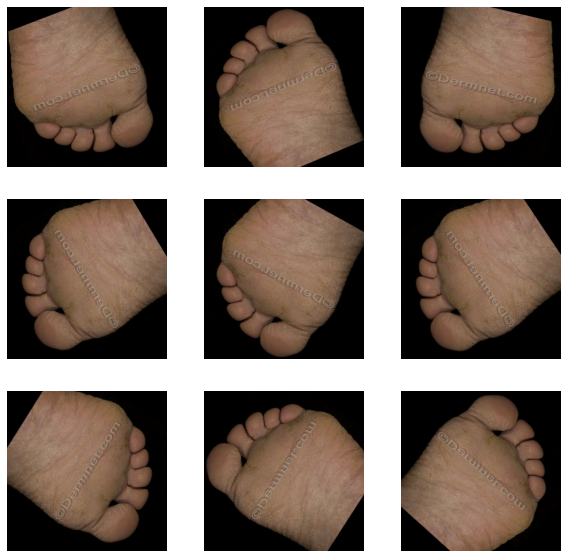

In [34]:
plt.figure(figsize=(10, 10))
for i in range(9):
    augmented_image = process_without_conv2D(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_image[0])
    plt.axis("off")
    

- By using the pre-processing layers, we can augment the images within the neural network. This will save some time on pre-processing and computational cost.
- When the model is exported, the pre-processing will be included as well, saving the effort to pre-process the images in a similar new dataset.
- If the dataset is different, the pre-processing layers have to be re-defined to suit the needs of the project.

# Build Convolutional Neural Network (cnn) with compiled `[without image pre-processing and dropout]`
- Previously, the data in compiled has been splitted into training and validate data.
- Training data will be used for training the cnn and validate data will be used for validation.


- Loss function will be categorical cross entropy although the labeling is binary. There are only 2 labels, 0 and 1 in this dataset. By putting the output nodes to be 2 and activation to be softmax, we will be able to see the output as range of probability values, values from both output nodes add up to be 1.

https://stackoverflow.com/questions/61742556/valueerror-shapes-none-1-and-none-2-are-incompatible

## Autotune the data to be flowed into cnn

In [35]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

cache_train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
cache_val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

- Autotune improves the performance of flowing the data into the cnn.

## Instantiate,compile and fit training & validate data to the cnn

In [36]:
# need to set seed for python core, numpy and tensorflow every time a neural network is ran to seed the neural network
# to obtain re-producible result

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)


# filters determine number of filters. the filters are randomly activated to allow machine to learn different features.

# filters = no. of filters
# kernel size = height/width of filter
# activation = activator function eg. relu, usually relu
# input_shape = shape of input, image input, eg pixel x pixel, how many layers, 3 = rgb


# instantiate the model
# img_height and Img_width is already defined as 480 but it will be re-defined here to ensure consistency
img_height = 480
img_width = 480

num_classes = 2

model = Sequential([
  layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  Conv2D(filters=16, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Flatten(),
  Dense(num_classes, activation  = 'softmax')
])

# compile model
model.compile(
  optimizer='adam',
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  
  metrics=["accuracy"]) 
# Sparse categorical cross entropy has to be used instead of binary cross entropy because softmax is used 
# in prediction layer and labels for photos are in integers, prediction layer has 2 nodes for output                                                   

# metrics set to "accuracy"; tensorflow will use the appropriate accuracy metric depending on the loss function

# specify class weights
weight_for_0 = 0.60
weight_for_1 = 0.40
class_weight = {0: weight_for_0, 1: weight_for_1}

# fit the model
epochs=20
history = model.fit(
  cache_train_ds,
  validation_data = cache_val_ds,
  class_weight=class_weight,
  epochs=epochs
)

Epoch 1/20
10/10 [==============================] - 20s 2s/step - loss: 0.8895 - accuracy: 0.5669 - val_loss: 0.6344 - val_accuracy: 0.6400
Epoch 2/20
10/10 [==============================] - 19s 2s/step - loss: 0.2905 - accuracy: 0.6786 - val_loss: 0.5707 - val_accuracy: 0.7333
Epoch 3/20
10/10 [==============================] - 22s 2s/step - loss: 0.2707 - accuracy: 0.7567 - val_loss: 0.5530 - val_accuracy: 0.7733
Epoch 4/20
10/10 [==============================] - 23s 2s/step - loss: 0.2159 - accuracy: 0.7599 - val_loss: 0.5364 - val_accuracy: 0.7467
Epoch 5/20
10/10 [==============================] - 23s 2s/step - loss: 0.2082 - accuracy: 0.8345 - val_loss: 0.5596 - val_accuracy: 0.6933
Epoch 6/20
10/10 [==============================] - 23s 2s/step - loss: 0.1932 - accuracy: 0.8337 - val_loss: 0.5052 - val_accuracy: 0.7333
Epoch 7/20
10/10 [==============================] - 23s 2s/step - loss: 0.1675 - accuracy: 0.8801 - val_loss: 0.4973 - val_accuracy: 0.7733
Epoch 8/20
10/10 [==

## Summary of output and no. of parameters created from each layer

In [37]:
# summary
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 480, 480, 3)       0         
_________________________________________________________________
conv2d (Conv2D)              (None, 480, 480, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 240, 240, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 240, 240, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 120, 120, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 120, 120, 64)      18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 60, 60, 64)       

## Plot the train accuracy & loss, test accuracy & loss over epochs for cnn `without dropout`

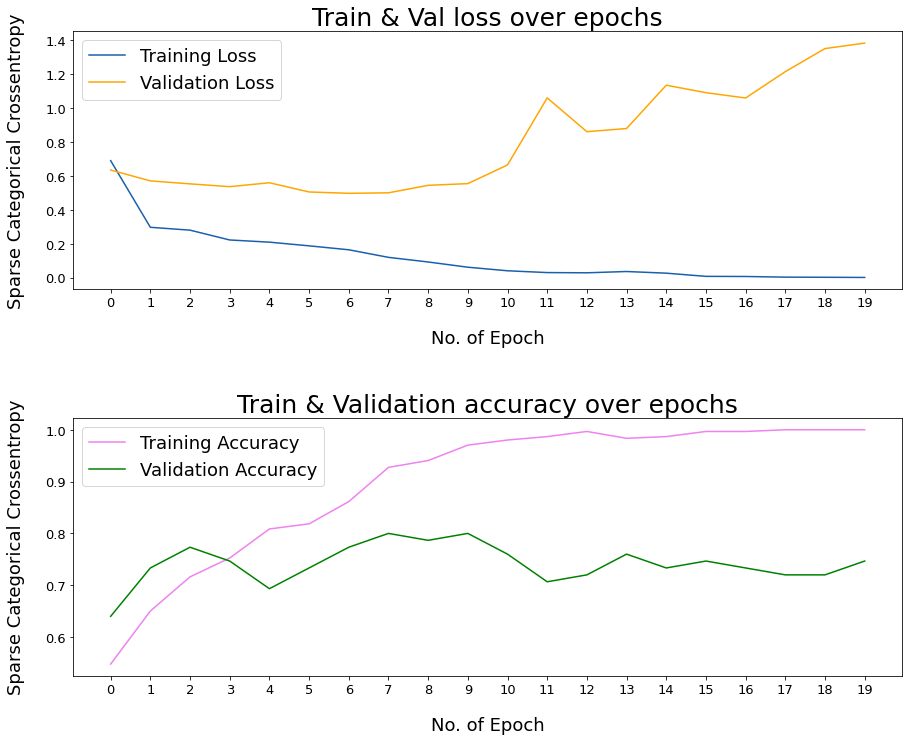

In [38]:
# Check train loss and test loss over epochs.
train_loss = history.history['loss']
val_loss = history.history['val_loss']
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
epochs_range = range(len(history.epoch))

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history.epoch[0], history.epoch[-1]+1)), 
           labels = list(range(history.epoch[0], history.epoch[-1]+1)),
           fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18);
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history.epoch[0], history.epoch[-1]+1)), 
           labels = list(range(history.epoch[0], history.epoch[-1]+1)),
           fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

- Model is overfit, there is a big gap between the training accuracy and validation accuracy.
- There is also a huge gap between training and validation loss.

## Predict for an image to test out cnn model `without dropout`
- I will use the model to predict for individual images just to check it out.

In [39]:
# path to images and assign variable names to them

# picture of a feet without eczema
gran_feet = path('C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/train/Systemic Disease/granuloma-annulare-128.jpg')

# picture of a feet with eczema (unseen data)
ec_feet = path('C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/feet/Unseen/eczema/05atopicFeet0801053.jpg')

### Show images

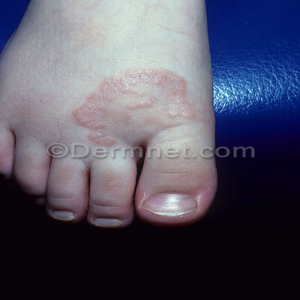

In [40]:
PIL.Image.open(gran_feet).resize((300,300))

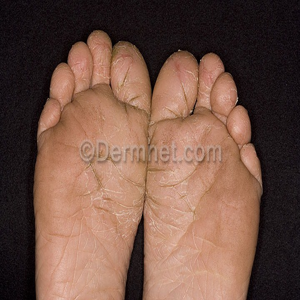

In [41]:
PIL.Image.open(ec_feet).resize((300,300))

### Pre-process image of a feet `without eczema` to prepare to feed into model for prediction

In [42]:
# load and assign the image as PIL image file
img_gran_feet = keras.preprocessing.image.load_img(
    gran_feet, target_size=(img_height, img_width)
)

# convert image into array
img_gran_feet_array = keras.preprocessing.image.img_to_array(img_gran_feet)

# add a dimension to the image, the cnn is trained with 4 dimensions hence image has to be converted into 4 dimensions
img_gran_feet_array = tf.expand_dims(img_gran_feet_array, 0)

In [43]:
type(img_gran_feet)

PIL.Image.Image

- load_image function converts the picture file into a PIL image file

### Predict for image of a feet `without eczema`

In [44]:
predictions = model.predict(img_gran_feet_array)

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to non-eczema with a 100.00 percent confidence.


- The model predicted the image to be non-eczema correctly with around 100% confidence.

### Pre-process image of a feet `with eczema` to prepare to feed into model for prediction

In [45]:
# load and assign the image as PIL image file
img_ec_feet = keras.preprocessing.image.load_img(
    ec_feet, target_size=(img_height, img_width)
)

# convert image into array
img_ec_feet_array = keras.preprocessing.image.img_to_array(img_ec_feet)

# add a dimension to the image, the cnn is trained with 4 dimensions hence image has to be converted into 4 dimensions
img_ec_feet_array = tf.expand_dims(img_ec_feet_array, 0)

### Predict for image of a feet `with eczema`

In [46]:
predictions = model.predict(img_ec_feet_array)


print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to Eczema with a 100.00 percent confidence.


- The model predicted the image to be eczema correctly with around 100% confidence.

### Pre-process image of an image `with melanoma` to prepare to feed into model for prediction

In [47]:
melanoma = path('C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/test/Melanoma Skin Cancer Nevi and Moles/atypical-nevi-23.jpg')

# load and assign the image as PIL image file
img_melanoma = keras.preprocessing.image.load_img(
    melanoma, target_size=(img_height, img_width)
)

# convert image into array
img_melanoma_array = keras.preprocessing.image.img_to_array(img_melanoma)

# add a dimension to the image, the cnn is trained with 4 dimensions hence image has to be converted into 4 dimensions
img_melanoma_array = tf.expand_dims(img_melanoma_array, 0)

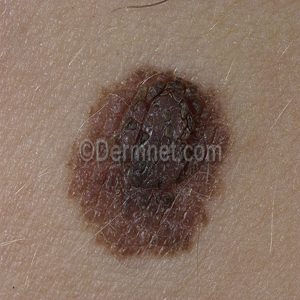

In [48]:
# show the image
PIL.Image.open(melanoma).resize((300,300))

### Predict for image of a skin `with melanoma`

In [49]:
predictions = model.predict(img_melanoma_array)


print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to non-eczema with a 99.98 percent confidence.


- The model predicted the image to be non-eczema correctly with around 99.98% confidence. Melanoma is a type of skin cancer. It is to be noted that the image is of a skin, and the model could have predicted correctly because it is not the shape of a feet.

## Summary of evaluation of cnn model `without image pre-processing and no dropout`

### Create dataset containing only eczema images (mixed, including feet)

In [21]:
# create dataset with 1 category only
batch_size = 32
img_height = 480
img_width = 480


unseen_data = image_dataset_from_directory(
  unseen,
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 120 files belonging to 1 classes.


- As mentioned previously, the unseen folder contains Eczema pictures from various body parts, including feet.
- The unseen_data tensorflow dataset will only have 1 class as it only contains eczema pictures.

In [51]:
# evaluate on training data to obtain base score for accuracy
model.evaluate(train_ds)

10/10 [==============================] - 8s 634ms/step - loss: 0.0021 - accuracy: 1.0000


[0.0020579600241035223, 1.0]

In [52]:
# evaluate on validation data to obtain validate score
model.evaluate(val_ds)

3/3 [==============================] - 2s 436ms/step - loss: 1.3828 - accuracy: 0.7467


[1.3827555179595947, 0.746666669845581]

In [53]:
# evaluate on unseen data
model.evaluate(unseen_data)

4/4 [==============================] - 3s 583ms/step - loss: 2.0249 - accuracy: 0.5417


[2.024895429611206, 0.5416666865348816]

- When given unseen data, the model was able to predict eczema in different body parts with around 54% accuracy. The accuracy is low, and it could be due to only eczema and non-eczema feet is used to train the machine.

### Look at the images `model` has predicted correctly in unseen_data

Predictions:
 [1 0 0 0 0 0 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0 0 0 1 0 1 0 1 0 1 1 1]
Labels:
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


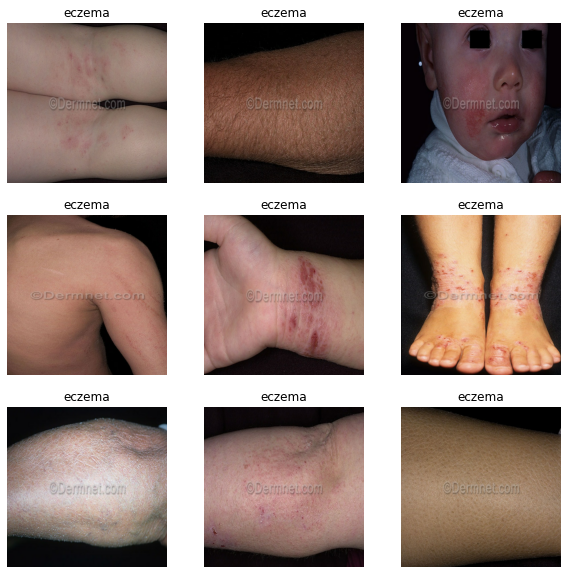

In [54]:
#Retrieve a batch of images from the unseen data
image, label = next(iter(unseen_data))
predictions = model.predict_on_batch(image)

# print  corresponding labels
print('Predictions:\n', np.argmax(predictions, axis=1))
print('Labels:\n', label.numpy())

# plot 9 pictures retrieved from 1 batch of 32 images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image[i].numpy().astype("uint8"))     
    plt.title(unseen_data.class_names[label[i]])    # shows correct label for corresponding image
    plt.axis("off")                                 # class 0 = eczema, class 1 = no eczema

In this trial run, the cnn model is used to predict for:
- feet image with eczema: predicted image as an eczema image (100% confidence) 
- feet image without eczema: predicted image as an non-eczema image (100% confidence)
- image of skin with melanoma: predicted image as an non-eczema image (99.98% confidence)


- train accuracy is 1.0000 (baseline)
- validate accuracy is 0.7467
- test accuracy for eczema in mixed body parts is 0.5417.

The model performance in predicting binary classification of eczema feet and non-eczema feet images is average. However, the model is overfitted (baseline: 1.0000 vs validation: 0.7467). I will add the image pre-processing layers to try reduce the overfitting.

# Build Convolutional Neural Network (cnn) with compiled `[with dropout & with image preprocessing]`

In [55]:
# define pre-processing layers

# rescaling scales the 8-bit color depth RGB values so that the values are normalized
process = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", input_shape=(img_height, img_width, 3)),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'reflect'),
  layers.experimental.preprocessing.Rescaling(1./255),
])

In [56]:
process

- In the previous example, the pre-processing layer is assigned to a variable and is used to show how it can be used in data augmentation for images.
- In the following steps, I will be using the keract library to display the images created at the different layers from Conv2D and MaxPooling. When the pre-processing layers are assigned to a variable, the library will not be able to call out the layers as the entire pre-process layer will be wrapped as a tensorflow engine object, as seen above.
- The pre-processing layers will be added into the cnn model initialization.

## Instantiate,compile and fit training & validate data to the cnn

In [57]:
# need to set seed for python core, numpy and tensorflow every time a neural network is ran to seed the neural network 

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# instantiate the model
# img_height and Img_width is already defined as 480 but it will be re-defined here to ensure consistency
img_height = 480
img_width = 480

num_classes = 2

# need to set functional / operational seed to pre-process layer although global seed has been set to obtain reproducible results
model_p = Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", input_shape=(img_height, img_width, 3), seed=1234),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'constant', seed=1234),
  layers.experimental.preprocessing.Rescaling(1./255),
  Conv2D(filters=16, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Dropout(0.2),
  Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Dropout(0.2),
  Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Dropout(0.2),
  Flatten(),
  Dense(num_classes, activation  = 'softmax')
])

# compile model
model_p.compile(
  optimizer='adam',
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output
# specify class weights
weight_for_0 = 0.60
weight_for_1 = 0.40
class_weight = {0: weight_for_0, 1: weight_for_1}        
        
# fit the model
epochs=20
history_p = model_p.fit(
  cache_train_ds,
  validation_data = cache_val_ds,
  class_weight=class_weight,
  epochs=epochs)

Epoch 1/20
10/10 [==============================] - 29s 3s/step - loss: 1.8300 - accuracy: 0.5232 - val_loss: 0.6585 - val_accuracy: 0.6000
Epoch 2/20
10/10 [==============================] - 29s 3s/step - loss: 0.3306 - accuracy: 0.6612 - val_loss: 0.6801 - val_accuracy: 0.6933
Epoch 3/20
10/10 [==============================] - 29s 3s/step - loss: 0.3267 - accuracy: 0.6156 - val_loss: 0.6418 - val_accuracy: 0.7733
Epoch 4/20
10/10 [==============================] - 29s 3s/step - loss: 0.3197 - accuracy: 0.6626 - val_loss: 0.6177 - val_accuracy: 0.7467
Epoch 5/20
10/10 [==============================] - 28s 3s/step - loss: 0.2939 - accuracy: 0.6948 - val_loss: 0.6007 - val_accuracy: 0.7333
Epoch 6/20
10/10 [==============================] - 29s 3s/step - loss: 0.2879 - accuracy: 0.7100 - val_loss: 0.6059 - val_accuracy: 0.7333
Epoch 7/20
10/10 [==============================] - 29s 3s/step - loss: 0.2853 - accuracy: 0.7266 - val_loss: 0.6015 - val_accuracy: 0.7200
Epoch 8/20
10/10 [==

## Summary of output and no. of parameters created from each layer

In [58]:
# summary
model_p.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
random_flip_2 (RandomFlip)   (None, 480, 480, 3)       0         
_________________________________________________________________
random_rotation_2 (RandomRot (None, 480, 480, 3)       0         
_________________________________________________________________
rescaling_3 (Rescaling)      (None, 480, 480, 3)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 480, 480, 16)      448       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 240, 240, 16)      0         
_________________________________________________________________
dropout (Dropout)            (None, 240, 240, 16)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 240, 240, 32)     

## Visualize the output from each layer of the model

random_flip_2_input (1, 480, 480, 3) 


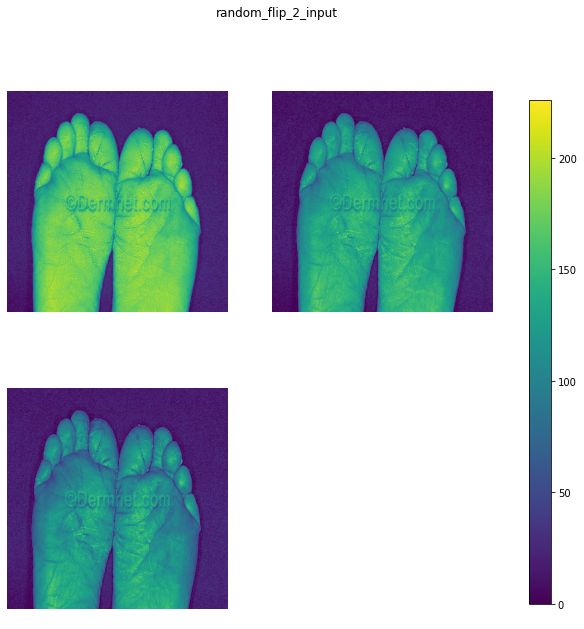

random_flip_2 (1, 480, 480, 3) 


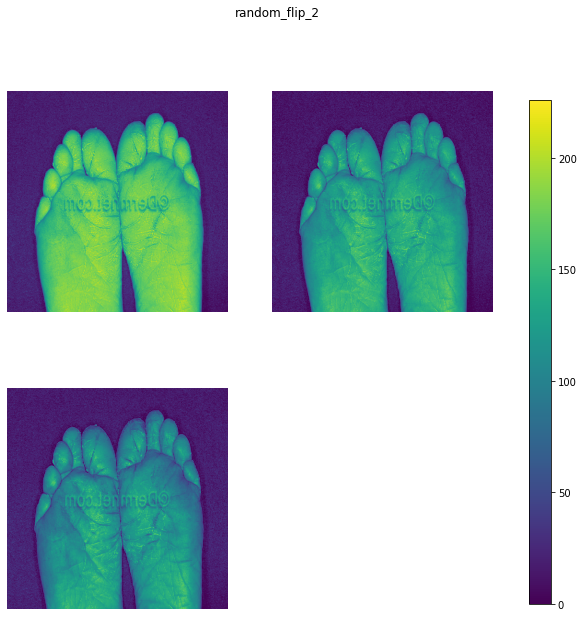

random_rotation_2 (1, 480, 480, 3) 


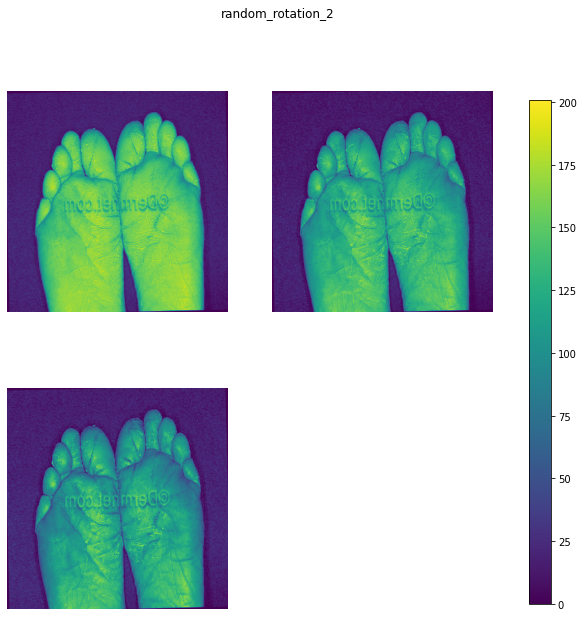

rescaling_3 (1, 480, 480, 3) 


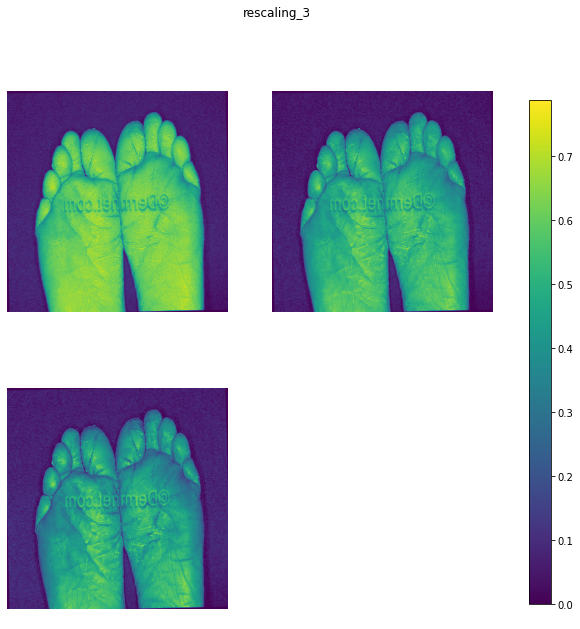

conv2d_3 (1, 480, 480, 16) 


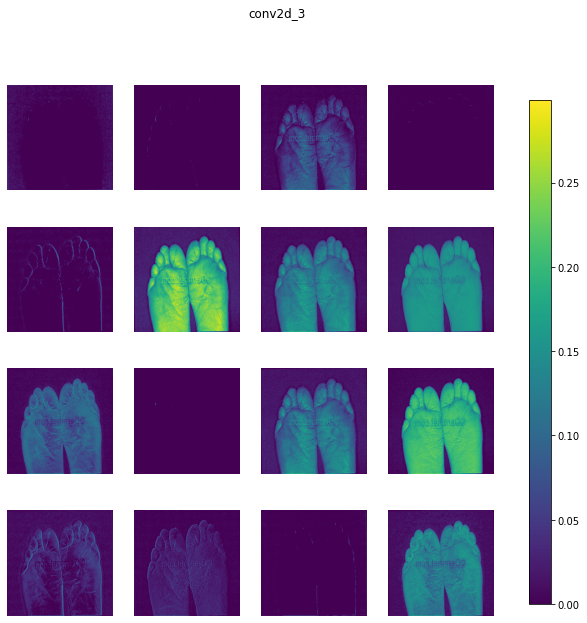

max_pooling2d_3 (1, 240, 240, 16) 


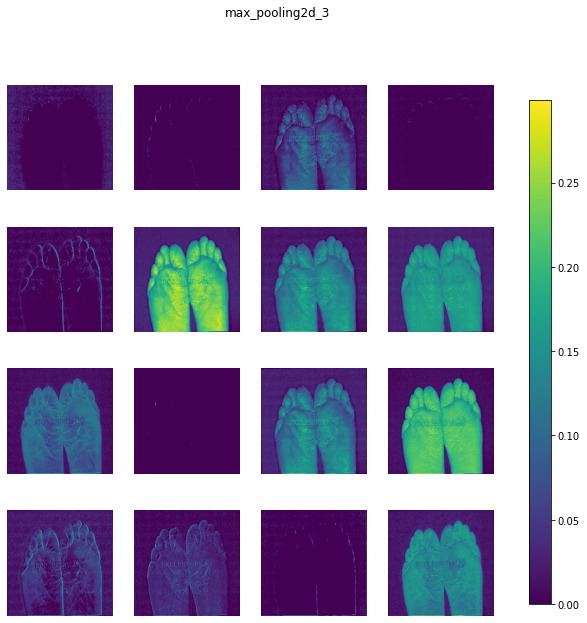

dropout (1, 240, 240, 16) 


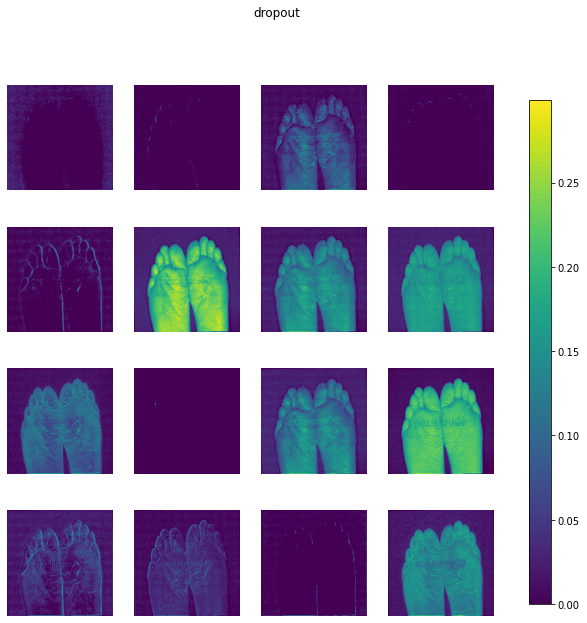

conv2d_4 (1, 240, 240, 32) 


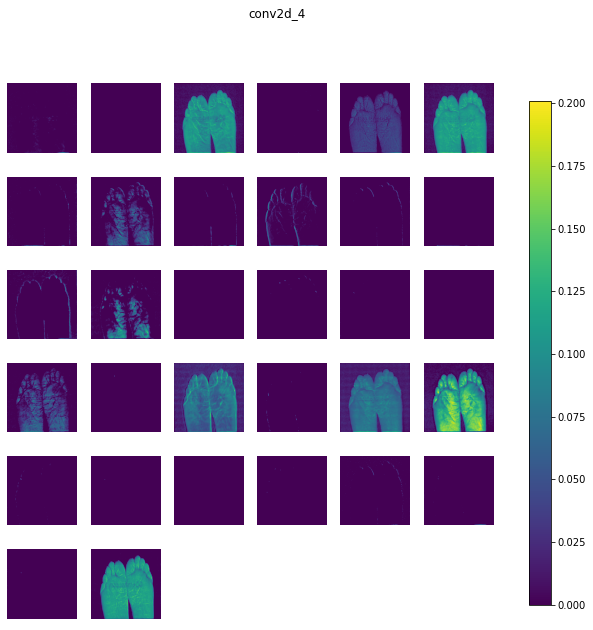

max_pooling2d_4 (1, 120, 120, 32) 


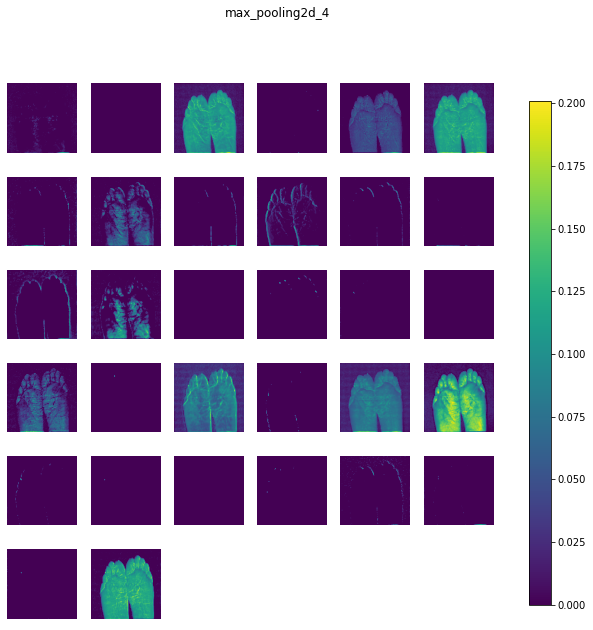

dropout_1 (1, 120, 120, 32) 


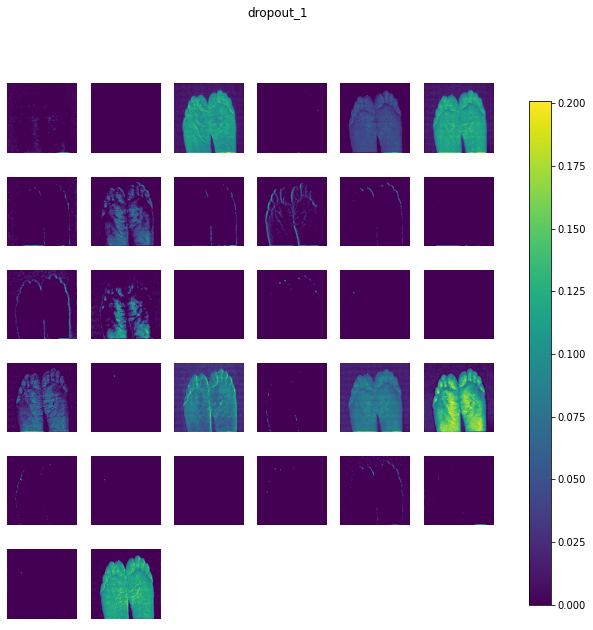

conv2d_5 (1, 120, 120, 64) 


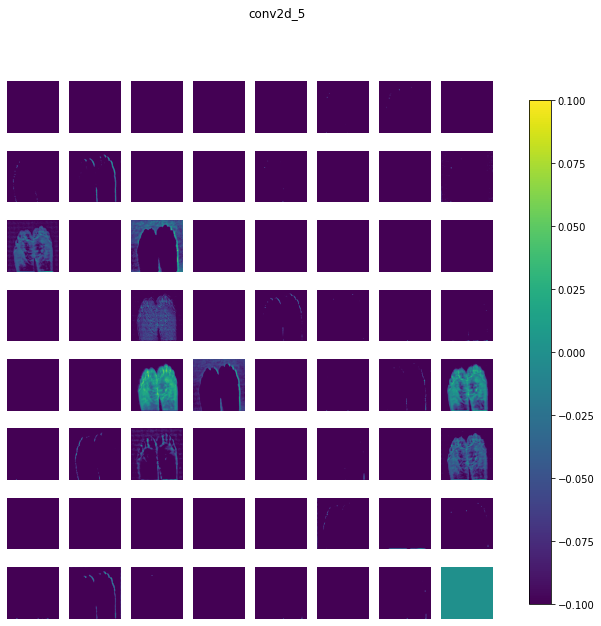

max_pooling2d_5 (1, 60, 60, 64) 


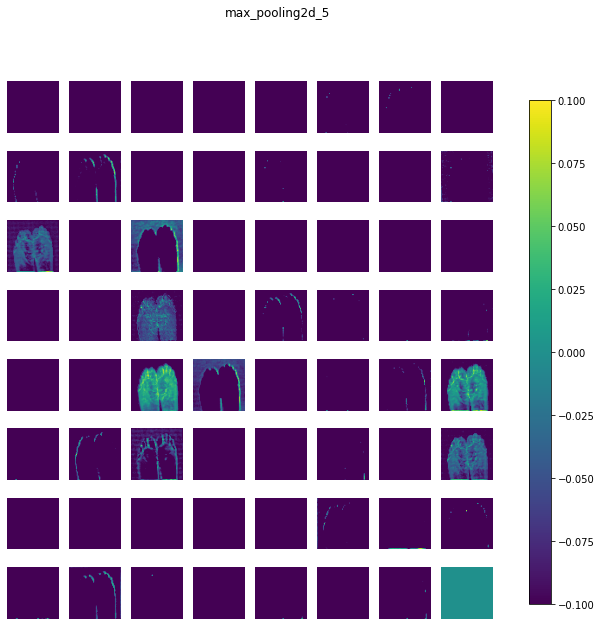

dropout_2 (1, 60, 60, 64) 


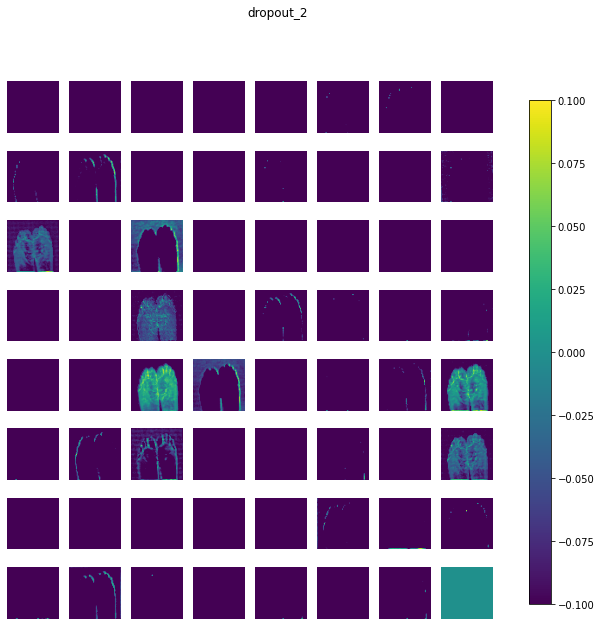

flatten_1 (1, 230400) 


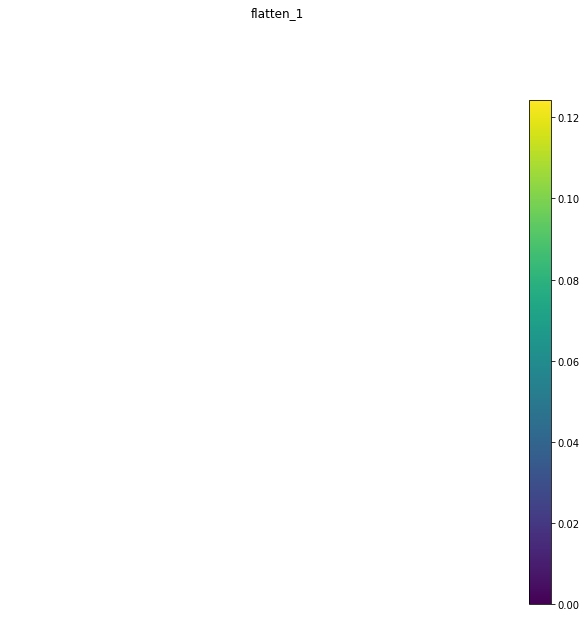

dense_1 (1, 2) 


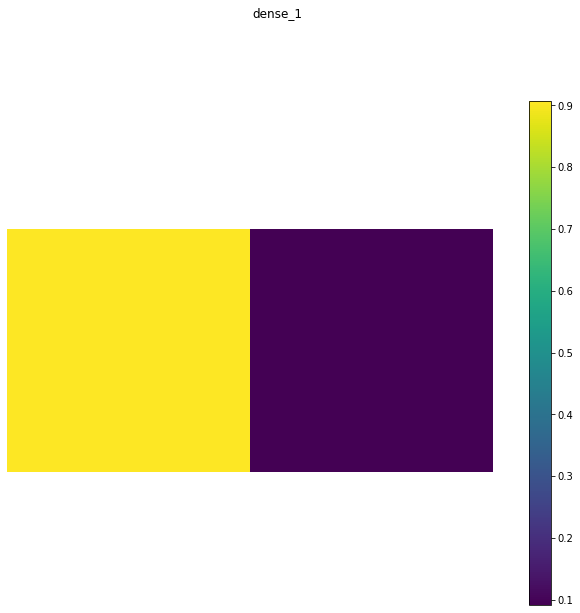

In [59]:
# use the keract library to visualize the output
activations = get_activations(model_p, img_ec_feet_array)

display_activations(activations, fig_size=(10, 10), save=False)

- In the pre-processing layers, the images have been flipped and rotated. With image pre-processing, there are random variations introduced to the image, as seen above. This is a form of image augmentation which will help to reduce overfitting.

## Plot the train loss and test loss over epochs for cnn `[with dropout & with image preprocessing]`

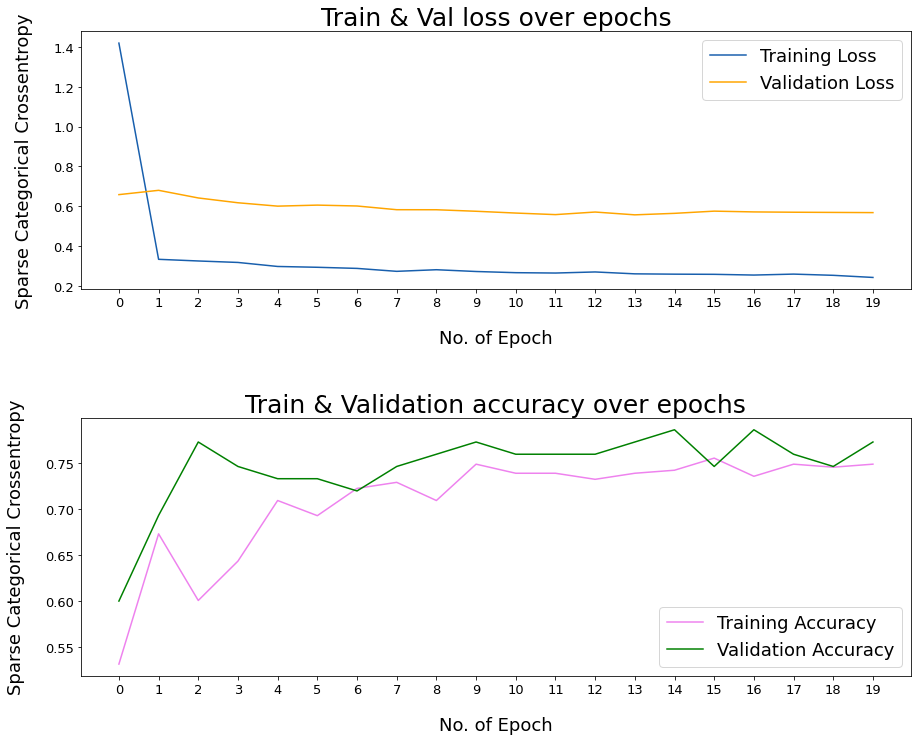

In [60]:
# Check train loss and test loss over epochs.
train_loss = history_p.history['loss']
val_loss = history_p.history['val_loss']
acc = history_p.history['accuracy']
val_acc = history_p.history['val_accuracy']
epochs_range = range(len(history_p.epoch))

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18);
plt.xticks(ticks = range(history_p.epoch[0], history_p.epoch[-1]+1),
                         labels = range(history_p.epoch[0], history_p.epoch[-1]+1), 
                           fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18)
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = range(history_p.epoch[0], history_p.epoch[-1]+1),
                         labels = range(history_p.epoch[0], history_p.epoch[-1]+1), 
                           fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

For the cnn model with image processing and dropout:
- The gap between the training loss and validation loss has decreased. Higher validation loss over trian loss is likely to be caused insufficient validation data. In this case, I am using the feet database as a trial run, where the number of images is limited.

https://machinelearningmastery.com/learning-curves-for-diagnosing-machine-learning-model-performance/


- The gap between training and validation accuracy is closer now. The image pre-processing and dropout seem to have reduced the overfitting.
- Model is less overfit after image processing.

### Predict for image of a feet `without eczema`

In [61]:
predictions = model_p.predict(img_gran_feet_array)
# score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to non-eczema with a 59.10 percent confidence.


### Predict for image of a feet `with eczema`

In [62]:
predictions = model_p.predict(img_ec_feet_array)
# score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to Eczema with a 92.06 percent confidence.


### Predict for image of a skin `with melanoma`

In [63]:
predictions = model_p.predict(img_melanoma_array)
# score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)


This image most likely belongs to non-eczema with a 52.70 percent confidence.


## Summary of evaluation of cnn model `with image pre-processing and dropout`

In [64]:
# evaluate on training data to obtain base score for accuracy
model_p.evaluate(train_ds)

10/10 [==============================] - 7s 621ms/step - loss: 0.5212 - accuracy: 0.7558


[0.5211619138717651, 0.7557755708694458]

In [65]:
# evaluate on validation data to obtain validate score
model_p.evaluate(val_ds)

3/3 [==============================] - 2s 434ms/step - loss: 0.5682 - accuracy: 0.7733


[0.5682464241981506, 0.7733333110809326]

In [66]:
# evaluate on unseen data 
model_p.evaluate(unseen_data)

4/4 [==============================] - 3s 598ms/step - loss: 0.7495 - accuracy: 0.5500


[0.74946528673172, 0.550000011920929]

### Look at the images `model_p` has predicted correctly in unseen_data

Predictions:
 [1 1 0 0 0 0 0 0 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 1 0 0 1 0 0]
Labels:
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


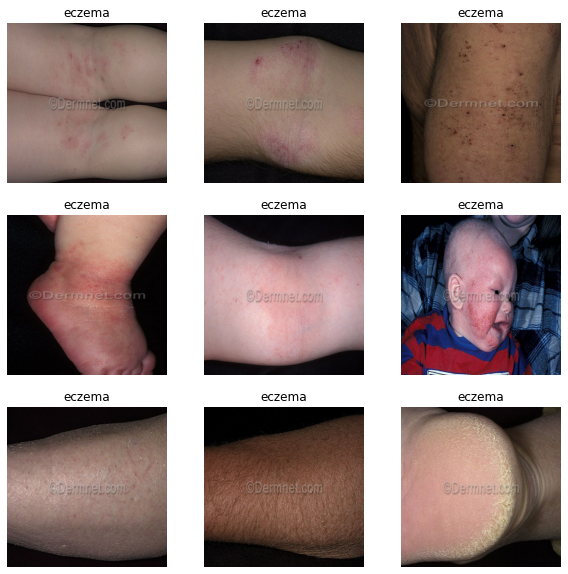

In [67]:
#Retrieve a batch of images from the unseen data
image, label = next(iter(unseen_data))
predictions = model_p.predict_on_batch(image)

# print  corresponding labels
print('Predictions:\n', np.argmax(predictions, axis=1))
print('Labels:\n', label.numpy())

# plot 9 pictures retrieved from 1 batch of 32 images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image[i].numpy().astype("uint8"))
    plt.title(unseen_data.class_names[label[i]])    # shows correct label for corresponding image
    plt.axis("off")                                 # class 1 = no eczema, class 0 = eczema

**Accuracy scores for model with image pre-processing**
- train accuracy is 0.7558 (baseline)
- validate accuracy is 0.7733
- test accuracy for eczema in mixed body parts is 0.5500.


**We compare the results from cnn without image pre-processing no dropout VS cnn with image pre-processing with dropout:**
- feet image without eczema (100% vs 59.10% confidence)
- feet image with eczema (100% vs 92.06% confidence)
- image of skin with melanoma (99.98% vs 52.70% confidence)
- test accuracy for eczema in mixed body parts is (0.5417 vs 0.5500)



- Cnn without image pre-processing no dropout has a much better accuracy when predicting for individual images given. However with image pre-processing, it reduced the overfitting and gap between training and validate loss.
- The test accuracy of cnn without image pre-processing no dropout is similar to that of cnn with image preprocessing with dropout.


**Conclusion for cnn model trained with feet images with eczema and no eczema:**

Overall, the accuracy of the model is quite poor. Next, I will build a cnn model trained with eczema and no eczema from various body parts, including feet and evaluate the performance.

# Create a cnn model with `image pre-processing and no dropout` with eczema and non-eczema images with mixed body parts, including feet
- The goal is to create a cnn model trained with mixed body parts which have eczema and non-eczema.
- I will evaluate if the machine is able to learn eczema and non-eczema in different body parts or not.

## Create a fixed dataset consisting of eczema and non-eczema with mixed body parts

- In the eczema_nonec_all_train folder, it contains pictures of mixed body parts that is categorized into Eczema and non-Eczema. For the eczema images, it contains eczema images from various body parts. For the non-eczema images, they are pictures of images from other skin diseases such as pityriasis (skin rash) and psoriasis (skin disorder that causes skin cells to multiply up to 10 times faster than normal. This makes the skin build up into bumpy red patches covered with white scales.) This data is used as the training data.


- In the eczema_nonec_all_test folder, it contains pictures of mixed body parts that is categorized into Eczema and non-Eczema. This data is used as the test data.

- Pictures from eczema_nonec_all_train train dataset is split into training data and validate data.
- Out of the 3127 files, 2502 is used as training data and 625 is used as validate data.


- Pictures from eczema_nonec_all_test is used as the test dataset, unseen by model. There are 774 files.

In [2]:
# path to train folder with all body parts
train = path("C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/eczema_nonec_all_train")

# path to test folder with all body parts
test = path("C:/Users/YT Koh/Documents/YT/Capstone/Computer vision - skin/eczema_nonec_all_test")


In [3]:
# training data

# split out training data from train dataset
batch_size = 32
img_height = 480
img_width = 480


train_ds = image_dataset_from_directory(
  train,
  validation_split=0.2,
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  subset="training",
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 3127 files belonging to 2 classes.
Using 2502 files for training.


In [4]:
# validate data

# split out validate data from train dataset
batch_size = 32
img_height = 480
img_width = 480


val_ds = image_dataset_from_directory(
  train,
  validation_split=0.2,
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  subset="validation",
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 3127 files belonging to 2 classes.
Using 625 files for validation.


In [5]:
# unseen data for testing
batch_size = 32
img_height = 480
img_width = 480


test_ds = image_dataset_from_directory(
  test,
  label_mode = 'int',     # label mode is set to integer so that the labels for each image is an integer
                          # so that categorical cross entropy can be used in cnn loss function
                          # and use 'softmax' as the activation function to output probability values
  seed=123,
  shuffle = True,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 774 files belonging to 2 classes.


## Check class distribution in training, validation and testing datasets

In [72]:
counter = 1
class_0 = []
class_1 = []

for image_batch, labels_batch in train_ds:
    for a in labels_batch.numpy():
        if a == 0:
            class_0.append(a)
        else:
            class_1.append(a)
    print(counter, labels_batch.shape)
    print(f'frequency of class 0 is {class_0.count(0)}, frequency of class 1 is {class_1.count(1)}')
    counter += 1

1 (32,)
frequency of class 0 is 17, frequency of class 1 is 15
2 (32,)
frequency of class 0 is 30, frequency of class 1 is 34
3 (32,)
frequency of class 0 is 47, frequency of class 1 is 49
4 (32,)
frequency of class 0 is 65, frequency of class 1 is 63
5 (32,)
frequency of class 0 is 81, frequency of class 1 is 79
6 (32,)
frequency of class 0 is 102, frequency of class 1 is 90
7 (32,)
frequency of class 0 is 122, frequency of class 1 is 102
8 (32,)
frequency of class 0 is 137, frequency of class 1 is 119
9 (32,)
frequency of class 0 is 154, frequency of class 1 is 134
10 (32,)
frequency of class 0 is 171, frequency of class 1 is 149
11 (32,)
frequency of class 0 is 183, frequency of class 1 is 169
12 (32,)
frequency of class 0 is 199, frequency of class 1 is 185
13 (32,)
frequency of class 0 is 225, frequency of class 1 is 191
14 (32,)
frequency of class 0 is 245, frequency of class 1 is 203
15 (32,)
frequency of class 0 is 260, frequency of class 1 is 220
16 (32,)
frequency of class 0 

In [73]:
print(f'Class 0 in train_ds is {train_ds.class_names[0]}, Class 1 in train_ds is {train_ds.class_names[1]}.')
print(f'Percentage of class 0 is {1379/2502 :.2f}, percentage of class 1 is {1123/2502 :.2f}.')

Class 0 in train_ds is Eczema, Class 1 in train_ds is No Eczema.
Percentage of class 0 is 0.55, percentage of class 1 is 0.45.


In [74]:
counter = 1
class_0 = []
class_1 = []

for image_batch, labels_batch in val_ds:
    for a in labels_batch.numpy():
        if a == 0:
            class_0.append(a)
        else:
            class_1.append(a)
    print(counter, labels_batch.shape)
    print(f'frequency of class 0 is {class_0.count(0)}, frequency of class 1 is {class_1.count(1)}')
    counter += 1

1 (32,)
frequency of class 0 is 18, frequency of class 1 is 14
2 (32,)
frequency of class 0 is 32, frequency of class 1 is 32
3 (32,)
frequency of class 0 is 52, frequency of class 1 is 44
4 (32,)
frequency of class 0 is 70, frequency of class 1 is 58
5 (32,)
frequency of class 0 is 89, frequency of class 1 is 71
6 (32,)
frequency of class 0 is 108, frequency of class 1 is 84
7 (32,)
frequency of class 0 is 127, frequency of class 1 is 97
8 (32,)
frequency of class 0 is 142, frequency of class 1 is 114
9 (32,)
frequency of class 0 is 159, frequency of class 1 is 129
10 (32,)
frequency of class 0 is 178, frequency of class 1 is 142
11 (32,)
frequency of class 0 is 193, frequency of class 1 is 159
12 (32,)
frequency of class 0 is 209, frequency of class 1 is 175
13 (32,)
frequency of class 0 is 225, frequency of class 1 is 191
14 (32,)
frequency of class 0 is 246, frequency of class 1 is 202
15 (32,)
frequency of class 0 is 264, frequency of class 1 is 216
16 (32,)
frequency of class 0 i

In [75]:
print(f'Class 0 in val_ds is {val_ds.class_names[0]}, Class 1 in val_ds is {val_ds.class_names[1]}.')
print(f'Percentage of class 0 is {343/625 :.2f}, percentage of class 1 is {282/625 :.2f}.')

Class 0 in val_ds is Eczema, Class 1 in val_ds is No Eczema.
Percentage of class 0 is 0.55, percentage of class 1 is 0.45.


In [76]:
counter = 1
class_0 = []
class_1 = []

for image_batch, labels_batch in test_ds:
    for a in labels_batch.numpy():
        if a == 0:
            class_0.append(a)
        else:
            class_1.append(a)
    print(counter, labels_batch.shape)
    print(f'frequency of class 0 is {class_0.count(0)}, frequency of class 1 is {class_1.count(1)}')
    counter += 1

1 (32,)
frequency of class 0 is 20, frequency of class 1 is 12
2 (32,)
frequency of class 0 is 37, frequency of class 1 is 27
3 (32,)
frequency of class 0 is 54, frequency of class 1 is 42
4 (32,)
frequency of class 0 is 71, frequency of class 1 is 57
5 (32,)
frequency of class 0 is 88, frequency of class 1 is 72
6 (32,)
frequency of class 0 is 112, frequency of class 1 is 80
7 (32,)
frequency of class 0 is 128, frequency of class 1 is 96
8 (32,)
frequency of class 0 is 143, frequency of class 1 is 113
9 (32,)
frequency of class 0 is 162, frequency of class 1 is 126
10 (32,)
frequency of class 0 is 185, frequency of class 1 is 135
11 (32,)
frequency of class 0 is 207, frequency of class 1 is 145
12 (32,)
frequency of class 0 is 221, frequency of class 1 is 163
13 (32,)
frequency of class 0 is 238, frequency of class 1 is 178
14 (32,)
frequency of class 0 is 249, frequency of class 1 is 199
15 (32,)
frequency of class 0 is 263, frequency of class 1 is 217
16 (32,)
frequency of class 0 i

In [77]:
print(f'Class 0 in val_ds is {test_ds.class_names[0]}, Class 1 in val_ds is {test_ds.class_names[1]}.')
print(f'Percentage of class 0 is {427/774 :.2f}, percentage of class 1 is {347/774 :.2f}.')

Class 0 in val_ds is Eczema, Class 1 in val_ds is no eczema.
Percentage of class 0 is 0.55, percentage of class 1 is 0.45.


### Summary of class distribution for training, validation and testing datasets

- **Class 0 is Eczema and Class 1 is non-eczema in train_ds, val_ds and test_ds.**
- In the training dataset, train_ds, percentage of class 0 is 0.55, percentage of class 1 is 0.45.
- I will specify the class weights when fitting the train data to the neural networks later to minimize the effect of class imbalance.

## Show the first 9 images in training data

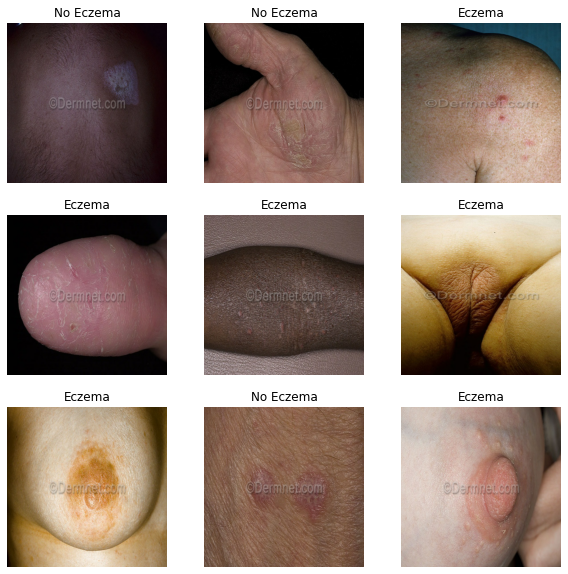

In [78]:
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(train_ds.class_names[labels[i]])
        plt.axis("off")

## Autotune the data to be flowed into cnn

In [7]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

cache_train_ds = train_ds.cache().prefetch(buffer_size=AUTOTUNE)
cache_val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

## Instantiate,compile and fit training & validate data to the cnn

In [80]:
# need to set seed for python core, numpy and tensorflow every time a neural network is ran to seed the neural network 

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)


# filters determine number of filters. the filters are randomly activated to allow machine to learn different features.

# filters = no. of filters
# kernel size = height/width of filter
# activation = activator function eg. relu, usually relu
# input_shape = shape of input, image input, eg pixel x pixel, how many layers, 3 = rgb


# instantiate the model
# img_height and Img_width is already defined as 480 but it will be re-defined here to ensure consistency
img_height = 480
img_width = 480

num_classes = 2

# need to set functional / operational seed to pre-process layer although global seed has been set to obtain reproducible results
model_fullbody = Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", input_shape=(img_height, img_width, 3), seed=1234),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'constant', seed=1234),
  layers.experimental.preprocessing.Rescaling(1./255),
  Conv2D(filters=16, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Conv2D(filters=32, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Conv2D(filters=64, kernel_size=3, padding='same', activation='relu'),
  MaxPooling2D(),
  Flatten(),
  Dense(num_classes, activation  = 'softmax')
])

# specify class weights
weight_for_0 = 0.55
weight_for_1 = 0.45
class_weight = {0: weight_for_0, 1: weight_for_1}      

# compile model
model_fullbody.compile(
  optimizer='adam',
  loss=keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output

# fit the model
epochs=20
history_fullbody = model_fullbody.fit(
  cache_train_ds,
  validation_data = cache_val_ds,
  class_weight=class_weight,
  epochs=epochs)

Epoch 1/20
79/79 [==============================] - 216s 3s/step - loss: 0.6317 - accuracy: 0.5200 - val_loss: 0.6679 - val_accuracy: 0.5936
Epoch 2/20
79/79 [==============================] - 206s 3s/step - loss: 0.3349 - accuracy: 0.5565 - val_loss: 0.6549 - val_accuracy: 0.6128
Epoch 3/20
79/79 [==============================] - 205s 3s/step - loss: 0.3305 - accuracy: 0.5713 - val_loss: 0.6553 - val_accuracy: 0.5520
Epoch 4/20
79/79 [==============================] - 208s 3s/step - loss: 0.3295 - accuracy: 0.5649 - val_loss: 0.6531 - val_accuracy: 0.5456
Epoch 5/20
79/79 [==============================] - 208s 3s/step - loss: 0.3284 - accuracy: 0.5621 - val_loss: 0.6493 - val_accuracy: 0.5632
Epoch 6/20
79/79 [==============================] - 207s 3s/step - loss: 0.3276 - accuracy: 0.5666 - val_loss: 0.6482 - val_accuracy: 0.5488
Epoch 7/20
79/79 [==============================] - 211s 3s/step - loss: 0.3259 - accuracy: 0.5846 - val_loss: 0.6492 - val_accuracy: 0.5472
Epoch 8/20
79

In [81]:
# Summary of output and no. of parameters created from each layer
model_fullbody.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
random_flip_3 (RandomFlip)   (None, 480, 480, 3)       0         
_________________________________________________________________
random_rotation_3 (RandomRot (None, 480, 480, 3)       0         
_________________________________________________________________
rescaling_4 (Rescaling)      (None, 480, 480, 3)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 480, 480, 16)      448       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 240, 240, 16)      0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 240, 240, 32)      4640      
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 120, 120, 32)     

## Visualize the output from each layer of the model

random_flip_3_input (1, 480, 480, 3) 


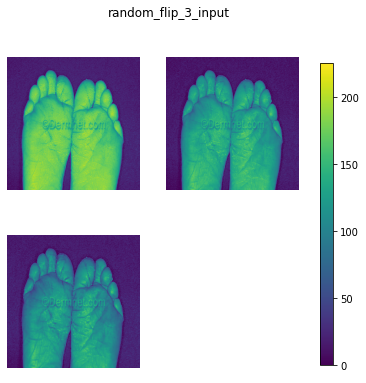

random_flip_3 (1, 480, 480, 3) 


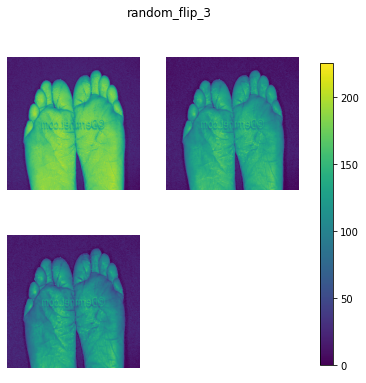

random_rotation_3 (1, 480, 480, 3) 


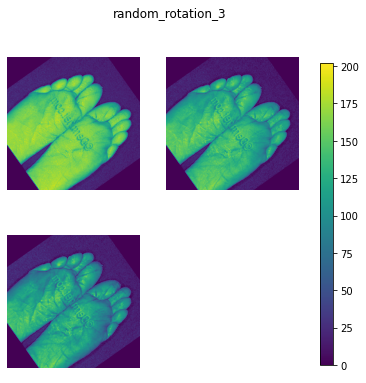

rescaling_4 (1, 480, 480, 3) 


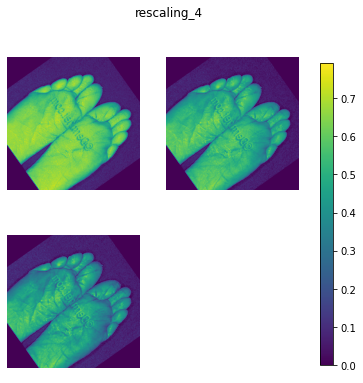

conv2d_6 (1, 480, 480, 16) 


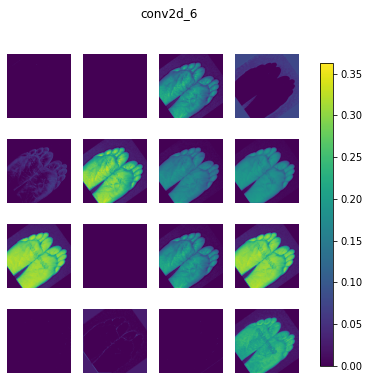

max_pooling2d_6 (1, 240, 240, 16) 


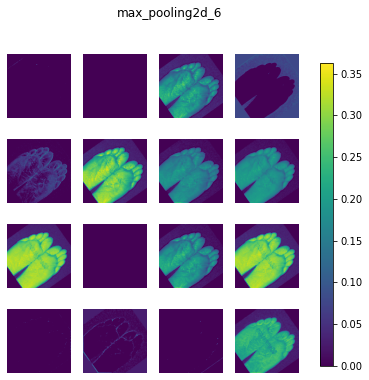

conv2d_7 (1, 240, 240, 32) 


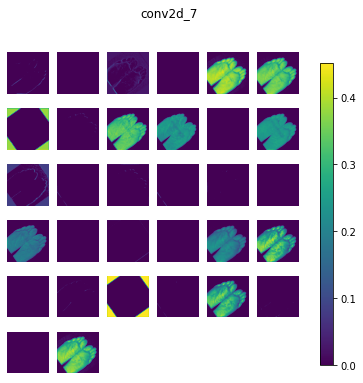

max_pooling2d_7 (1, 120, 120, 32) 


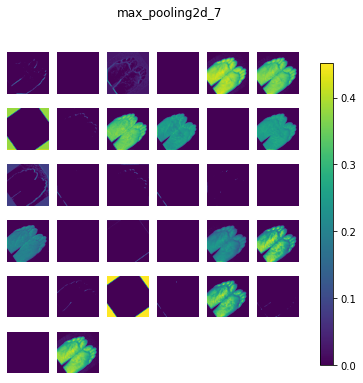

conv2d_8 (1, 120, 120, 64) 


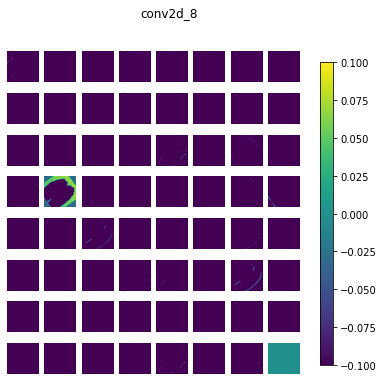

max_pooling2d_8 (1, 60, 60, 64) 


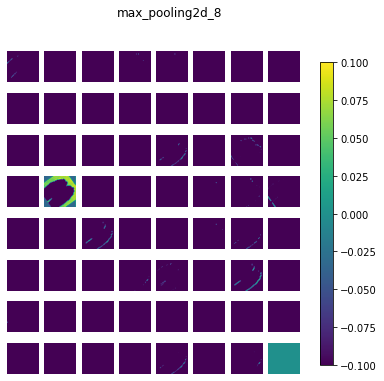

flatten_2 (1, 230400) 


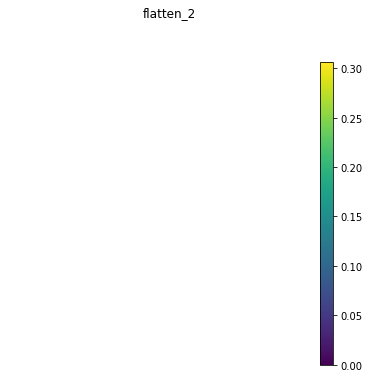

dense_2 (1, 2) 


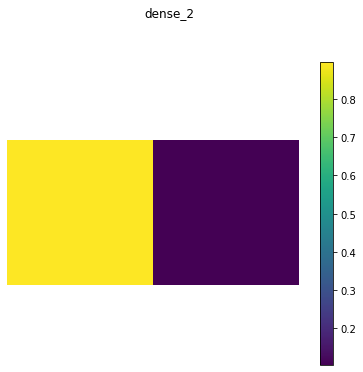

In [82]:
# use the keract library to visualize the output
activations = get_activations(model_fullbody, img_ec_feet_array)

display_activations(activations, fig_size=(6, 6), save=False)

- As shown previously, In the pre-processing layers, the images have been flipped and rotated. With image pre-processing, there are random variations introduced to the image, as seen above. This is a form of image augmentation which will help to reduce overfitting. Here, the rotation of the image is more apparent.

## Plot the train accuracy & loss, test accuracy & loss over epochs for cnn `without dropout`

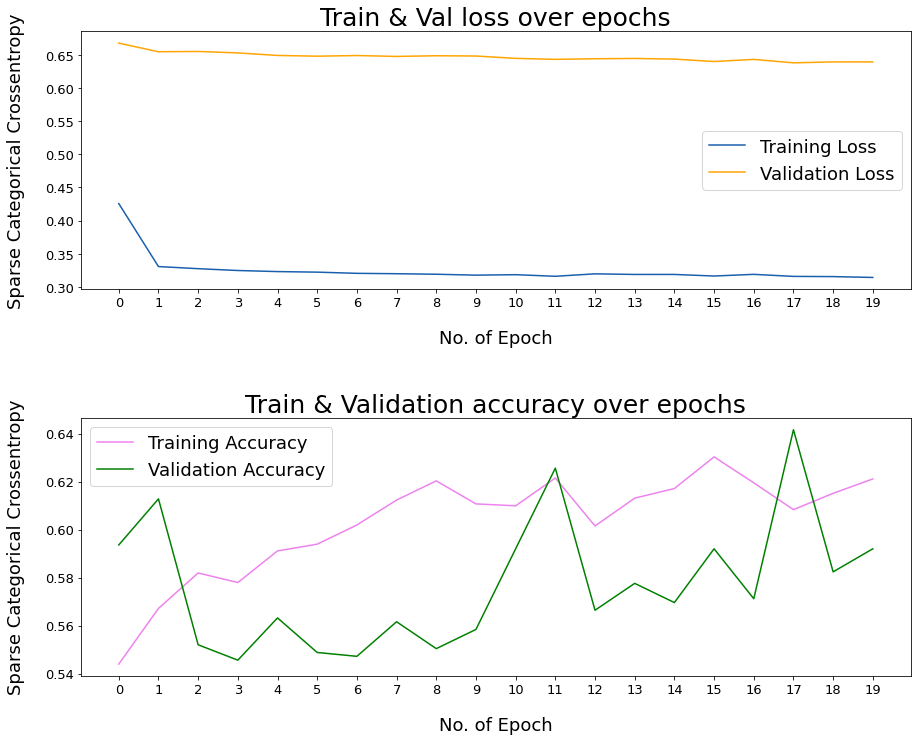

In [83]:
# Check train loss and test loss over epochs.
train_loss = history_fullbody.history['loss']
val_loss = history_fullbody.history['val_loss']
acc = history_fullbody.history['accuracy']
val_acc = history_fullbody.history['val_accuracy']
epochs_range = range(len(history_fullbody.epoch))

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = range(history_fullbody.epoch[0], history_fullbody.epoch[-1]+1),
                         labels = range(history_fullbody.epoch[0], history_fullbody.epoch[-1]+1), 
                           fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18);
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = range(history_fullbody.epoch[0], history_fullbody.epoch[-1]+1),
                         labels = range(history_fullbody.epoch[0], history_fullbody.epoch[-1]+1), 
                           fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

For the cnn model with image processing and no dropout for the mixed body parts dataset:
- The gap between the training loss and validation loss is big. In this case, higher validation loss over train loss could be caused by insufficient validation data. Or, it is an indicator that the model is not performing well, and is underfitted.
- The gap between training and validation accuracy is moderately close. The image pre-processing seem to have reduced the overfitting.
- I will look at the evaluation scores later to see if there is overfitting or underfitting.

### Predict for image of a feet `without eczema`

In [148]:
predictions = model_fullbody.predict(img_gran_feet_array)

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)

This image most likely belongs to Eczema with a 98.47 percent confidence.


### Predict for image of a feet `with eczema`

In [149]:
predictions = model_fullbody.predict(img_ec_feet_array)

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)

This image most likely belongs to Eczema with a 96.06 percent confidence.


### Predict for image of a skin `with melanoma`

In [150]:
predictions = model_fullbody.predict(img_melanoma_array)

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(train_ds.class_names[np.argmax(predictions)], 100 * np.max(predictions))
)

This image most likely belongs to Eczema with a 51.16 percent confidence.


## Summary of evaluation of cnn model `with image pre-processing and no dropout` for mixed body parts

In [87]:
# evaluate on training data to obtain base score for accuracy
model_fullbody.evaluate(train_ds)

79/79 [==============================] - 68s 847ms/step - loss: 0.6359 - accuracy: 0.6059


[0.6359229683876038, 0.6059152483940125]

In [88]:
# evaluate on validation data to obtain validation score for accuracy
model_fullbody.evaluate(val_ds)

20/20 [==============================] - 17s 787ms/step - loss: 0.6396 - accuracy: 0.5920


[0.6396018862724304, 0.5920000076293945]

In [89]:
# evaluate on test data to obtain test score for accuracy
model_fullbody.evaluate(test_ds)

25/25 [==============================] - 20s 766ms/step - loss: 0.6471 - accuracy: 0.5943


[0.6470522880554199, 0.594315230846405]

In [90]:
# evaluate on unseen data (eczema images from various body parts) to obtain test score for accuracy
model_fullbody.evaluate(unseen_data)

4/4 [==============================] - 3s 672ms/step - loss: 0.4676 - accuracy: 0.9417


[0.4675690233707428, 0.9416666626930237]

### Look at the images `model_fullbody` has predicted correctly for different body parts in test_ds

Predictions:
 [0 0 0 0 0 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]
Labels:
 [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


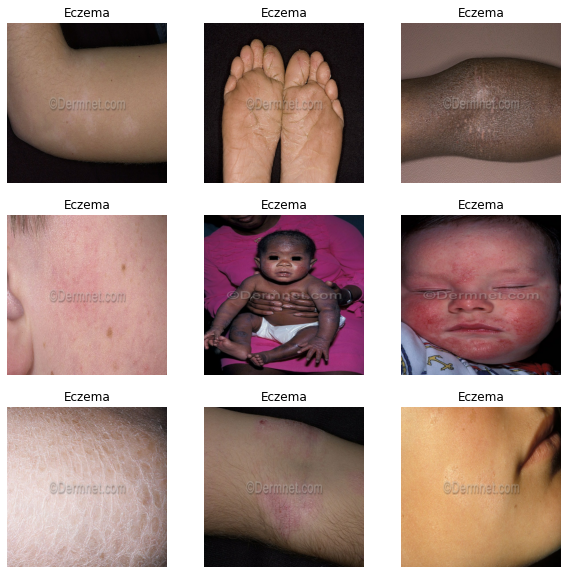

In [91]:
#Retrieve a batch of images from the unseen data
image, label = next(iter(unseen_data))
predictions = model_fullbody.predict_on_batch(image)

# print  corresponding labels
print('Predictions:\n', np.argmax(predictions, axis=1))
print('Labels:\n', label.numpy())

# plot 9 pictures retrieved from 1 batch of 32 images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image[i].numpy().astype("uint8"))
    plt.title(test_ds.class_names[label[i]])    # shows correct label for corresponding image
    plt.axis("off")                                 # class 0 = eczema, class 1 = no eczema, 

**Accuracy scores for model with image pre-processing**
- train accuracy is 0.6059 (baseline)
- validate accuracy is 0.5920
- test accuracy for eczema in mixed body parts (test_ds) is 0.5943
- unseen_data (dataset consisting of eczema images from various body parts) accuracy is 0.9417


The model is not overfit after evaluating the model. Overall, the accuracy of the model is quite poor at around 60% accuracy. Next, I will utilize transfer learning to build another cnn model. The MobileNet V2 will be used as the base model.

# Using Transfer Learning for Feature Extraction
- I will use the MobileNet V2 pre-trained base model for feature extraction. The MobileNet V2 model is developed at Google. This is pre-trained on the ImageNet dataset, a large dataset consisting of 1.4M images and 1000 classes. ImageNet is a research training dataset with a wide variety of categories like jackfruit and syringe. From this, I will evaluate if it helps to increase accuracy for my dataset.
Reference link: https://www.tensorflow.org/tutorials/images/transfer_learning


- It is hoped that by using the extensive images and research that has been done to create the MobileNet V2, it will help to increase the accuracy of classifying eczema and non-eczema from mixed body parts.


- **include_top** will be set to false (include_top=False) so that a network that does not include the classification layers at the top, which is ideal for feature extraction, will be downloaded.


- Instead of using sequential from tensorflow.keras.models, I will be using the Keras Functional API from keras to chain together the data augmentation, rescaling, base_model and feature extractor. It is not possible to freeze the batch normalization layers using sequential function. This can only be set by using the Keras Functional API. It is very important to freeze the batch normalization layers in the base model, which is MobileNet V2 in this case, so that their weights are not updated during training. 


- The batch normalization layer contains 2 non-trainable weights that get updated during training. These are the variables tracking the mean and variance of the inputs during training. The batch normalization layer will standardize the inputs to a layer in a deep learning neural network.
https://en.wikipedia.org/wiki/Batch_normalization


- I will be training the model using dataset that contains eczema and non-eczema from mixed body parts.

In [92]:
# Create the base model from the pre-trained model MobileNet V2
# [96, 128, 160, 192, 224] are the available image size shapes
IMG_SIZE = (224, 224)

# model will take in 224 x 224 x 3 image
IMG_SHAPE = IMG_SIZE + (3,)
v2_base_model = tf.keras.applications.MobileNetV2(input_shape=(224,224,3),
                                               include_top=False,
                                               weights='imagenet')  # weights will be taken from imagenet

In [93]:
# shows the structure of the base model
v2_base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   
_______________________________________________________________________________

In [94]:
len(v2_base_model.layers)

154

In [95]:
# resizing function to resize image to 224 x 224
# base_model can only take in 224 x 224
resize = layers.experimental.preprocessing.Resizing(224, 224)

image_batch, label_batch = next(iter(train_ds))
image_batch = resize(image_batch)
feature_batch = v2_base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 1280)


In [96]:
feature_batch[0].shape

TensorShape([7, 7, 1280])

- There are 154 layers in v2_base_model.
- When v2_base_model is used as the feature extractor,it converts each 224 x 224 x 3 image into a 7 x 7 x 1280 block of features.

## Pre-processing inputs into the model
- The MobileNetV2 model expects pixel values in [-1,1], but at this point, the pixel values in the images are still in [0-255].
- tf.keras.applications models come with their own pre-processing function, the pre-processing function that came with MobileNetV2 converts the pixel values to [-1,1].

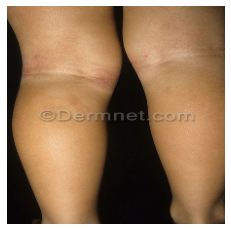

In [151]:
# show image from image_batch
plt.imshow(image_batch[1].numpy().astype("uint8"))
plt.axis("off");

In [98]:
image_batch[0]

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[117.78725 ,  83.78725 ,  73.78725 ],
        [121.359184,  87.359184,  77.359184],
        [118.651024,  84.651024,  74.651024],
        ...,
        [108.35714 ,  80.35714 ,  68.35714 ],
        [110.21428 ,  82.21428 ,  70.21428 ],
        [113.89284 ,  85.89284 ,  73.89284 ]],

       [[120.274445,  86.274445,  76.274445],
        [121.04422 ,  87.04422 ,  77.04422 ],
        [124.30293 ,  90.30293 ,  80.30293 ],
        ...,
        [108.35714 ,  80.35714 ,  68.35714 ],
        [110.21428 ,  82.21428 ,  70.21428 ],
        [113.89284 ,  85.89284 ,  73.89284 ]],

       [[114.74439 ,  80.74439 ,  70.74439 ],
        [124.69005 ,  90.69005 ,  80.69005 ],
        [124.09081 ,  90.09081 ,  80.09081 ],
        ...,
        [108.85765 ,  80.85765 ,  69.84694 ],
        [110.21428 ,  82.21428 ,  71.20357 ],
        [113.89284 ,  85.89284 ,  74.882126]],

       ...,

       [[130.52782 ,  97.52781 ,  82.52781 ],
        [146.

- As seen above, in 1 image extracted from the batch, the RGB values in the pixels are from [0-255].

In [99]:
tf.keras.applications.mobilenet_v2.preprocess_input(image_batch[0])

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[-0.07617843, -0.34284514, -0.4212765 ],
        [-0.04816324, -0.31482995, -0.3932613 ],
        [-0.06940371, -0.33607042, -0.4145018 ],
        ...,
        [-0.1501401 , -0.36974794, -0.46386558],
        [-0.13557428, -0.3551821 , -0.44929975],
        [-0.10672283, -0.32633066, -0.42044836]],

       [[-0.05667102, -0.32333767, -0.40176904],
        [-0.05063355, -0.31730026, -0.39573163],
        [-0.02507502, -0.29174173, -0.3701731 ],
        ...,
        [-0.1501401 , -0.36974794, -0.46386558],
        [-0.13557428, -0.3551821 , -0.44929975],
        [-0.10672283, -0.32633066, -0.42044836]],

       [[-0.10004395, -0.36671066, -0.44514203],
        [-0.02203882, -0.28870553, -0.3671369 ],
        [-0.0267387 , -0.2934054 , -0.37183678],
        ...,
        [-0.14621449, -0.36582237, -0.45218086],
        [-0.13557428, -0.3551821 , -0.44154066],
        [-0.10672283, -0.32633066, -0.4126892 ]],

       ...,

     

- After processing with pre-processing function that came with MobileNetV2, the RGB values are normalized to the range of [-1,1].

### Check that the image is not distorted after converting the RGB values to [-1,1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


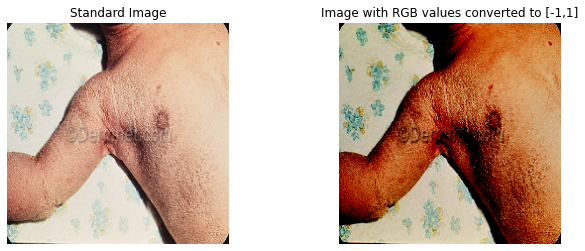

In [154]:
# image RGB converted to [-1,1] vs normal image
rescaler = tf.keras.applications.mobilenet_v2.preprocess_input
rs_image = rescaler(image_batch[2])

# plot images
plt.figure(figsize=(8, 8))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, wspace=0.5)

plt.subplot(1, 2, 1)
plt.imshow(image_batch[2].numpy().astype("uint8"))
plt.title('Standard Image')
plt.axis("off")

plt.subplot(1, 2, 2)
plt.title('Image with RGB values converted to [-1,1]')
plt.imshow(rs_image)
plt.axis('off')
plt.show()

- The image is not distorted, it looks different due to conversion of RGB values.

## Add a binary classification head to the v2_base_model

In [101]:
feature_batch.shape

TensorShape([32, 7, 7, 1280])

In [102]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


- To generate predictions from the block of features (7 x 7 x 1280), I will average the spatial 7 x 7 spatial locations, using the tf.keras.layers.GlobalAveragePooling2D layer to convert the features to a single 1280-element vector per image.
- The above is an example to show that the layers.GlobalAveragePooling2D() averages the spatial locations to a single element vector. The shape is (32, 1280), where 32 is the batch number and 1280 is the number of features.

In [103]:
# Create the base model from the pre-trained model MobileNet V2
# [96, 128, 160, 192, 224] are the available image size shapes
IMG_SIZE = (224, 224)

# model will take in 224 x 224 x 3 image
IMG_SHAPE = IMG_SIZE + (3,)
v2_base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               pooling = 'avg',    # set to avg so that the output of model is a 2D tensor
                                               weights='imagenet')  # weights will be taken from imagenet

In [104]:
# resizing function to resize image to 224 x 224
# base_model can only take in 224 x 224
resize = layers.experimental.preprocessing.Resizing(224, 224)

image_batch, label_batch = next(iter(train_ds))
image_batch = resize(image_batch)
feature_batch = v2_base_model(image_batch)
print(feature_batch.shape)

(32, 1280)


In [105]:
v2_base_model.layers[154]

In [106]:
len(v2_base_model.layers)

155

- While the GlobalAveragePooling2D layer can be used to convert the features to a single 1280-element vector per image, there is a parameter `pooling` in the MobileNetV2 that allows for the pooling to be set to average so that the output is a 2D tensor, same as our objective in using the GlobalAveragePooling2D layer.
- I will re-instantiate the MobileNetV2 by calling the pooling parameter and set to 'avg'.
- As seen above the output shape is (32,1280).
- The GlobalAveragePooling2D layer is added as the last output layer when `pooling = 'avg'`.

## Freeze the v2_base_model

- At this point, it is important and we need to freeze the convolutional base before compiling and training the model. MobileNet V2 has many layers, by setting **v2_base_model.trainable = False**, this sets the entire model's trainable flag to False and will freeze all the layers.
- The code will be included when instantiating the model later.

In [107]:
prediction_layer = tf.keras.layers.Dense(2, activation  = 'softmax')
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 2)


- I will use softmax for the prediction layer. By putting the output nodes to be 2 and activation to be softmax, we will be able to see the output as range of probability values, values from both output nodes add up to be 1.
-  The above is an example to show the prediction layer will convert the features to 2 outputs per image.

# Create a cnn model with image pre-processing, v2_base_model and feature extractor, with `dropout`
- Now a new model is created by chaining together the image pre-processing layers, base_model and feature extractor layers.

In [108]:
# need to set seed for python core, numpy and tensorflow every time a neural network is ran to seed the neural network 

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# Create the base model from the pre-trained model MobileNet V2
# [96, 128, 160, 192, 224] are the available image size shapes
IMG_SIZE = (224, 224)

# reload the import of base model in this code block to seed
# model will take in 224 x 224 x 3 image
IMG_SHAPE = IMG_SIZE + (3,)
v2_base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               pooling = 'avg',    # set to avg so that the output of model is a 2D tensor
                                               weights='imagenet')  # weights will be taken from imagenet

# set trainable = False
v2_base_model.trainable = False


# define the different layers in keras API

# data_augmentation layer (image pre-processing)
data_augmentation = Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", seed=1234),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'constant', seed=1234),
  layers.experimental.preprocessing.Resizing(224, 224)
])

# pre-process input layer (convert RGB values in the pixels to [-1,1])
# in the keras API, it is possible to use the preprocess_input function that comes with the mobilenet_v2
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

# prediction layer to classify the images into eczema and no eczema
# using softmax to generate probability values
prediction_layer = Dense(2, activation  = 'softmax')

# instantiate the keras API model
inputs = tf.keras.Input(shape=(480, 480, 3))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = v2_base_model(x, training=False)   # very important, set training = False to lock the batch normalisation layers
x = layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model_v2 = keras.Model(inputs, outputs)

# compile the model
base_learning_rate = 0.0001
model_v2.compile(optimizer = keras.optimizers.Adam(lr=base_learning_rate),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output

# specify class weights
weight_for_0 = 0.55
weight_for_1 = 0.45
class_weight = {0: weight_for_0, 1: weight_for_1}      
        
# fit the model
initial_epochs = 20

history_v2 = model_v2.fit(
  cache_train_ds,
  validation_data = cache_val_ds,
  class_weight=class_weight,
  epochs=initial_epochs)

Epoch 1/20
79/79 [==============================] - 75s 925ms/step - loss: 0.4232 - accuracy: 0.5028 - val_loss: 0.7376 - val_accuracy: 0.5744
Epoch 2/20
79/79 [==============================] - 74s 935ms/step - loss: 0.3779 - accuracy: 0.5520 - val_loss: 0.7083 - val_accuracy: 0.5936
Epoch 3/20
79/79 [==============================] - 71s 900ms/step - loss: 0.3608 - accuracy: 0.5733 - val_loss: 0.6869 - val_accuracy: 0.6096
Epoch 4/20
79/79 [==============================] - 70s 890ms/step - loss: 0.3550 - accuracy: 0.5940 - val_loss: 0.6767 - val_accuracy: 0.6240
Epoch 5/20
79/79 [==============================] - 74s 942ms/step - loss: 0.3497 - accuracy: 0.6129 - val_loss: 0.6707 - val_accuracy: 0.6224
Epoch 6/20
79/79 [==============================] - 72s 912ms/step - loss: 0.3404 - accuracy: 0.6102 - val_loss: 0.6634 - val_accuracy: 0.6224
Epoch 7/20
79/79 [==============================] - 69s 874ms/step - loss: 0.3299 - accuracy: 0.6356 - val_loss: 0.6609 - val_accuracy: 0.6224

In [109]:
len(model_v2.trainable_variables)

2

- From the above, only the prediction layer has been set to trainable.

In [110]:
model_v2.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 480, 480, 3)]     0         
_________________________________________________________________
sequential_5 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract (TFOpLambda (None, 224, 224, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 1280)              2257984   
_________________________________________________________________
dropout_3 (Dropout)          (None, 1280)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 2562

- As the base model has been set to untrainable, each of the node in the classification head layer (prediction_layer) will take in the inputs from the output of 1280, hence the trainable params is 2562, inclusive of bias / intercept for each node.

## Plot the train accuracy & loss, test accuracy & loss over epochs for cnn using v2_base_model as feature extractor

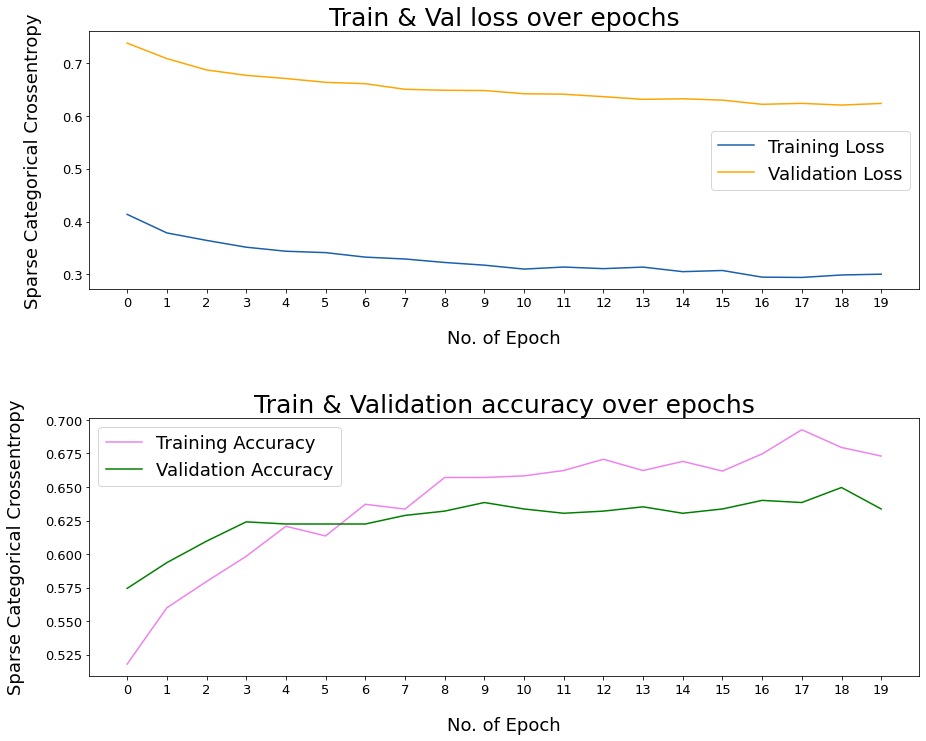

In [111]:
# Check train loss and test loss over epochs.
train_loss = history_v2.history['loss']
val_loss = history_v2.history['val_loss']
acc = history_v2.history['accuracy']
val_acc = history_v2.history['val_accuracy']
epochs_range = range(len(history_v2.epoch))

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column  epochs_range

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad = 20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history_v2.epoch[0], history_v2.epoch[-1]+1)), 
           labels = list(range(history_v2.epoch[0], history_v2.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18)
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history_v2.epoch[0], history_v2.epoch[-1]+1)), 
           labels = list(range(history_v2.epoch[0], history_v2.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

For the cnn model with image processing and no dropout using MobileNet V2 as feature extractor for the mixed body parts dataset:

- The gap between the training loss and validation loss is big. In this case, higher validation loss over train loss could be caused by insufficient validation data. Or, it is an indicator that the model, even with using transfer learning is not performing well, and is underfit.
- The gap between training and validation accuracy is moderately close.
- I will look at the evaluation scores later to see if there is overfitting or underfitting.

## Summary for evaluation of cnn model v2 without fine tuning

In [112]:
# evaluate on training data to obtain base score for accuracy
model_v2.evaluate(train_ds)

79/79 [==============================] - 53s 664ms/step - loss: 0.5937 - accuracy: 0.6807


[0.5936546325683594, 0.6806554794311523]

In [113]:
# evaluate on validate data to obtain validate score for accuracy
model_v2.evaluate(val_ds)

20/20 [==============================] - 13s 619ms/step - loss: 0.6235 - accuracy: 0.6336


[0.6234883069992065, 0.6335999965667725]

In [114]:
# evaluate on unseen data
model_v2.evaluate(unseen_data)

4/4 [==============================] - 3s 544ms/step - loss: 0.4132 - accuracy: 0.8417


[0.4132055938243866, 0.8416666388511658]

In [115]:
# evaluate on test_ds data
model_v2.evaluate(test_ds)

25/25 [==============================] - 16s 618ms/step - loss: 0.6155 - accuracy: 0.6822


[0.6154747605323792, 0.682170569896698]

### Look at the images `model_v2` has predicted correctly for different body parts in test_ds

In [116]:
# show the labels for the classes in test_ds
print(f' Class 0 is {test_ds.class_names[0]}.')
print(f' Class 1 is {test_ds.class_names[1]}.')

 Class 0 is Eczema.
 Class 1 is no eczema.


Predictions:
 [0 0 0 1 0 0 1 0 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0]
Labels:
 [0 0 1 1 0 0 1 1 0 1 1 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 0]


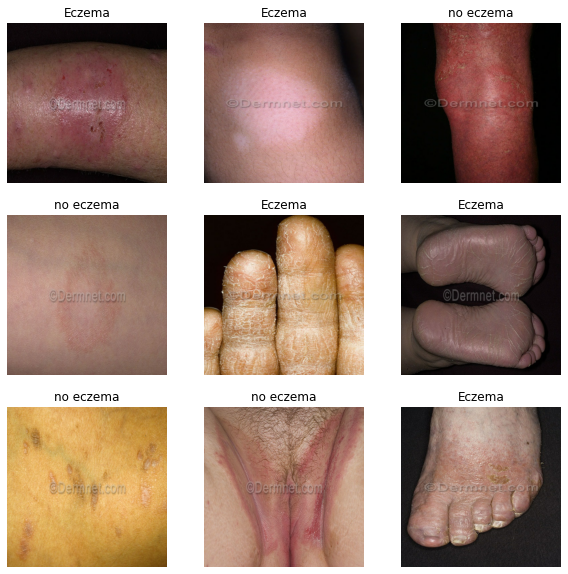

In [117]:
#Retrieve a batch of images from the unseen data
image, label = next(iter(test_ds))
predictions = model_v2.predict_on_batch(image)

# print  corresponding labels
print('Predictions:\n', np.argmax(predictions, axis=1))
print('Labels:\n', label.numpy())

# plot 9 pictures retrieved from 1 batch of 32 images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image[i].numpy().astype("uint8"))
    plt.title(test_ds.class_names[label[i]])      # shows correct label for corresponding image
    plt.axis("off")                               

**Accuracy scores for cnn model v2 with image pre-processing and dropout**
- train accuracy is 0.6807 (baseline)
- validate accuracy is 0.6336
- test accuracy for eczema in mixed body parts is 0.6822.
- unseen_data (dataset consisting of eczema images from various body parts) accuracy is 0.8417

- The model is not overfit. By using the MobileNet V2 model to predict for this dataset, which consist of eczema and non-eczema from various body parts. The accuracy achieved is around 68%. The result is an increase from the previous model, where the test accuracy is at around 60%. However, the unseen_data accuracy for the previous model is higher (84% vs 94%).

# Fine Tune MobileNet V2 to try increase accuracy by unfreezing 25 layers
- As seen previously, there are 155 layers in MobileNet V2
- I will fine tune the MobileNetV2 by re-training the top 25 layers from the base_model with the eczema and non-eczema from various body parts dataset.

## Unfreeze the v2_base_model

- By setting **v2_base_model.trainable = True**, this sets the entire model's trainable flag to True and will `un-freeze` all the layers.
- The code will be included when instantiating the model later.

### Set the layers to be tuned 
- Here,  I will set the bottom layers to be un-trainable and set the top layers to be trainable accordingly.
- As mentioned previously, there are 155 layers in v2_base_model as shown below including the GlobalAveragePooling2D layer.

In [118]:
print(f'There are {len(v2_base_model.layers)} layers in v2_base_model.')

There are 155 layers in v2_base_model.


In [119]:
# print out and look at the layers to be locked (set to untrainable)
for layers_to_be_locked in v2_base_model.layers[:130]:
    print(layers_to_be_locked)

In [120]:
len(v2_base_model.layers[:130])

130

- The top layers contain the features which are increasingly more specific to the dataset on which the model was trained on.
- The objective of fine-tuning is to adapt the specialized features (top layers) to work better with the new dataset, in this way, I will be tuning the top layers to cater to my dataset rather than overwriting the generic learning
- From the above, we can see the list of 130 layers that will be set to untrainable by setting `layer.trainable = False`

In [121]:
# print out and look at the layers to be unlocked and to be trained and tweaked to training data
for layers_to_be_trained in v2_base_model.layers[130:]:
    print(layers_to_be_trained)

In [122]:
len(v2_base_model.layers[130:])

25

- Here, the top layers containing the features which are increasingly more specific to the dataset on which the model was trained on will be set to trainable. These layers will be excluded from the loop later, so that the layers are set to `layer.trainable = True`

- From the above, we can see the list of 25 layers that will be set to trainable.

### Continue training the model by tuning 25 top layers

In [123]:
# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# set trainable = True
v2_base_model.trainable = True

# Fine-tune from this layer onwards
fine_tune_at = 130

# Freeze all the layers before the `fine_tune_at` layer
for layer in v2_base_model.layers[:fine_tune_at]:
    layer.trainable =  False

# compile the model
base_learning_rate = 0.0001
model_v2.compile(optimizer = keras.optimizers.Adam(lr=base_learning_rate/10),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output

# specify class weights
weight_for_0 = 0.55
weight_for_1 = 0.45
class_weight = {0: weight_for_0, 1: weight_for_1}             
        
# fit the model
initial_epochs = 20
fine_tune_epochs = 30
total_epochs = initial_epochs + fine_tune_epochs

history_v2_fine25 = model_v2.fit(cache_train_ds,
  epochs = total_epochs,
  initial_epoch = history_v2.epoch[-1],  # continue training from the last epoch of model not fine tuned                                      
  validation_data = cache_val_ds,        # train for 30 epochs more
  class_weight = class_weight                                       
  )

Epoch 20/50
79/79 [==============================] - 81s 989ms/step - loss: 0.3085 - accuracy: 0.6656 - val_loss: 0.6125 - val_accuracy: 0.6480
Epoch 21/50
79/79 [==============================] - 78s 992ms/step - loss: 0.2766 - accuracy: 0.7116 - val_loss: 0.6011 - val_accuracy: 0.6624
Epoch 22/50
79/79 [==============================] - 78s 992ms/step - loss: 0.2709 - accuracy: 0.7178 - val_loss: 0.5901 - val_accuracy: 0.6784
Epoch 23/50
79/79 [==============================] - 78s 995ms/step - loss: 0.2668 - accuracy: 0.7109 - val_loss: 0.5778 - val_accuracy: 0.6704
Epoch 24/50
79/79 [==============================] - 78s 985ms/step - loss: 0.2656 - accuracy: 0.7193 - val_loss: 0.5784 - val_accuracy: 0.6768
Epoch 25/50
79/79 [==============================] - 78s 987ms/step - loss: 0.2589 - accuracy: 0.7397 - val_loss: 0.5678 - val_accuracy: 0.6880
Epoch 26/50
79/79 [==============================] - 78s 988ms/step - loss: 0.2463 - accuracy: 0.7583 - val_loss: 0.5785 - val_accuracy:

In [124]:
len(v2_base_model.trainable_variables)

24

In [125]:
v2_base_model.trainable_variables[-1]

<tf.Variable 'Conv_1_bn/beta:0' shape=(1280,) dtype=float32, numpy=
array([-4.7684956, -4.237782 , -4.897689 , ..., -4.6497345, -4.604576 ,
       -4.598076 ], dtype=float32)>

- The trainable layers in the base model is 24, excluding the GlobalAveragePooling2D layer, after checking the structure of the layers.
- The batch normalization layer is the last layer, however, their weights will not be updated as `training = False`

In [126]:
v2_base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   
_______________________________________________________________________________

- In the summary of the base model, it can be seen that the trainable parameters has increased to 1,360,000, which includes the predictions layer.

In [127]:
# show the summary of the model
model_v2.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 480, 480, 3)]     0         
_________________________________________________________________
sequential_5 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.truediv (TFOpLambda) (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract (TFOpLambda (None, 224, 224, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 1280)              2257984   
_________________________________________________________________
dropout_3 (Dropout)          (None, 1280)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 2562

- In the final model with 25 layers of the base model unfrozen, the total number of trainable parameters is 1,362,562. 2,562 is from the prediction layer.

## Plot the train accuracy & loss, test accuracy & loss over epochs for cnn for `model_v2` after tuning 25 top layers

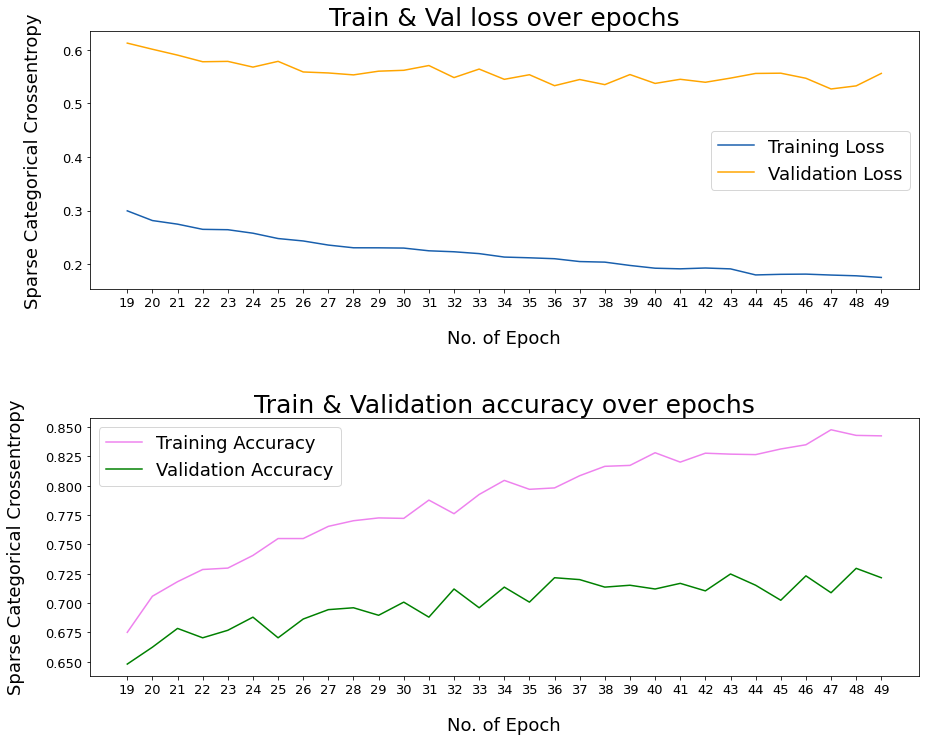

In [129]:
# Check train loss and test loss over epochs.
train_loss = history_v2_fine25.history['loss']
val_loss = history_v2_fine25.history['val_loss']
acc = history_v2_fine25.history['accuracy']
val_acc = history_v2_fine25.history['val_accuracy']
epochs_range = range(history_v2_fine25.epoch[0], history_v2_fine25.epoch[-1]+1)

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad = 20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18);
plt.xticks(ticks = list(range(history_v2_fine25.epoch[0], history_v2_fine25.epoch[-1]+1)), 
           labels = list(range(history_v2_fine25.epoch[0], history_v2_fine25.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18);
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history_v2_fine25.epoch[0], history_v2_fine25.epoch[-1]+1)), 
           labels = list(range(history_v2_fine25.epoch[0], history_v2_fine25.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

For the cnn model with image processing and no dropout using MobileNet V2 after tuning 25 top layers for the mixed body parts dataset:

- The gap between the training loss and validation loss is big. In this case, higher validation loss over train loss could be caused by insufficient validation data. Or, it is an indicator that the model, even with using transfer learning is not performing well, and is underfit.
- The gap between training and validation accuracy is seem to have increased.
- I will look at the evaluation scores later to see if there is overfitting or underfitting.

## Summary for evaluation of cnn model v2 with fine tuning of 25 top layers

In [130]:
# evaluate on training data to obtain base score for accuracy
model_v2.evaluate(train_ds)

79/79 [==============================] - 48s 600ms/step - loss: 0.4079 - accuracy: 0.8125


[0.40786319971084595, 0.8125499486923218]

In [131]:
# evaluate on validate data to obtain validate score for accuracy
model_v2.evaluate(val_ds)

20/20 [==============================] - 13s 618ms/step - loss: 0.5560 - accuracy: 0.7216


[0.5559879541397095, 0.7215999960899353]

In [132]:
# evaluate on unseen data
model_v2.evaluate(unseen_data)

4/4 [==============================] - 3s 496ms/step - loss: 0.2382 - accuracy: 0.9333


[0.2382335364818573, 0.9333333373069763]

In [133]:
# evaluate on test_ds data
model_v2.evaluate(test_ds)

25/25 [==============================] - 17s 625ms/step - loss: 0.5540 - accuracy: 0.7313


[0.5540146827697754, 0.7312661409378052]

**Accuracy scores for cnn model v2 with image pre-processing and dropout with fine tuning of 25 top layers** 

- train accuracy is 0.8125 (baseline)
- validate accuracy is 0.7216
- test accuracy for eczema in mixed body parts is 0.9333
- unseen_data (dataset consisting of eczema images from various body parts) accuracy is 0.7313
- the model is overfit, however the accuracy is modest

Overall, the accuracy of the model has increased after fine tuning 25 top layers of the base model. I will fine tune the base model more by increasing the number of layers to be tuned from 25 to 55.

# Fine Tune MobileNet V2 to try increase accuracy by unfreezing 55 layers
- As seen previously, there are 155 layers in MobileNet V2
- I will fine tune the MobileNetV2 by re-training the top 55 layers from the base_model with the eczema and non-eczema from various body parts dataset.

## Reinstantiate the process to create a model with 55 layers from the base model (MobileNet V2) unfrozen

In [8]:
# need to set seed for python core, numpy and tensorflow every time a neural network is ran to seed the neural network 

# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# Create the base model from the pre-trained model MobileNet V2
# [96, 128, 160, 192, 224] are the available image size shapes
IMG_SIZE = (224, 224)

# model will take in 224 x 224 x 3 image
IMG_SHAPE = IMG_SIZE + (3,)
v2_base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               pooling = 'avg',    # set to avg so that the output of model is a 2D tensor
                                               weights='imagenet')  # weights will be taken from imagenet

#set trainable = False
v2_base_model.trainable = False

# define the different layers in keras API

# data_augmentation layer (image pre-processing)
data_augmentation = Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", seed=1234),
  layers.experimental.preprocessing.RandomRotation(0.2, fill_mode = 'constant', seed=1234),
  layers.experimental.preprocessing.Resizing(224, 224)
])

# pre-process input layer (convert RGB values in the pixels to [-1,1])
# in the keras API, it is possible to use the preprocess_input function that comes with the mobilenet_v2
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

# prediction layer to classify the images into eczema and no eczema
# using softmax to generate probability values
prediction_layer = Dense(2, activation  = 'softmax')

# instantiate the keras API model
inputs = tf.keras.Input(shape=(480, 480, 3))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = v2_base_model(x, training=False)   # very important, set training = False to lock the batch normalisation layers
x = layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model_v2_tune50 = keras.Model(inputs, outputs)

# compile the model
base_learning_rate = 0.0001
model_v2_tune50.compile(optimizer = keras.optimizers.Adam(lr=base_learning_rate),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output
# specify class weights
weight_for_0 = 0.55
weight_for_1 = 0.45
class_weight = {0: weight_for_0, 1: weight_for_1}          
        
# fit the model
initial_epochs = 20

history_v2_tune50 = model_v2_tune50.fit(
  cache_train_ds,
  validation_data = cache_val_ds,
  class_weight = class_weight,
  epochs=initial_epochs)

Epoch 1/20
79/79 [==============================] - 64s 770ms/step - loss: 0.4183 - accuracy: 0.5108 - val_loss: 0.7314 - val_accuracy: 0.5696
Epoch 2/20
79/79 [==============================] - 65s 827ms/step - loss: 0.3877 - accuracy: 0.5459 - val_loss: 0.7070 - val_accuracy: 0.5904
Epoch 3/20
79/79 [==============================] - 66s 837ms/step - loss: 0.3752 - accuracy: 0.5752 - val_loss: 0.6873 - val_accuracy: 0.6208
Epoch 4/20
79/79 [==============================] - 67s 844ms/step - loss: 0.3437 - accuracy: 0.6062 - val_loss: 0.6759 - val_accuracy: 0.6208
Epoch 5/20
79/79 [==============================] - 69s 877ms/step - loss: 0.3387 - accuracy: 0.6052 - val_loss: 0.6680 - val_accuracy: 0.6240
Epoch 6/20
79/79 [==============================] - 68s 862ms/step - loss: 0.3281 - accuracy: 0.6337 - val_loss: 0.6599 - val_accuracy: 0.6288
Epoch 7/20
79/79 [==============================] - 68s 867ms/step - loss: 0.3243 - accuracy: 0.6556 - val_loss: 0.6540 - val_accuracy: 0.6352

In [9]:
model_v2_tune50.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 480, 480, 3)]     0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.truediv_1 (TFOpLambd (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract_1 (TFOpLamb (None, 224, 224, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 1280)              2257984   
_________________________________________________________________
dropout_1 (Dropout)          (None, 1280)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 2562

- Check that the re-instantiated model is instantiated correctly, trainable parameters should be 2,562.

In [14]:
# set seed for python core
rnd.seed(123)

# set seed for numpy, keras takes random number generator from numpy
np.random.seed(123)

# set seed for tensorflow
tf.random.set_seed(1234)

# set trainable = True
v2_base_model.trainable = True

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in v2_base_model.layers[:fine_tune_at]:
    layer.trainable =  False

# compile the model
base_learning_rate = 0.0001
model_v2_tune50.compile(optimizer = keras.optimizers.Adam(lr=base_learning_rate/10),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(),  # Sparse categorical cross entropy has to be used instead of  
  metrics=["accuracy"])                            # binary cross entropy because softmax is used in prediction layer and 
                                                    # labels for photos are in integers
                                                    # prediction layer has 2 nodes for output

# specify class weights
weight_for_0 = 0.55
weight_for_1 = 0.45
class_weight = {0: weight_for_0, 1: weight_for_1}           
        
# fit the model
initial_epochs = 20
fine_tune_epochs = 30
total_epochs = initial_epochs + fine_tune_epochs

history_v2_fine50 = model_v2_tune50.fit(cache_train_ds,
    epochs = total_epochs,
    initial_epoch = history_v2_tune50.epoch[-1],  # continue training from the last epoch of model not fine tuned                                      
    validation_data = cache_val_ds,                # train for 30 epochs more
    class_weight = class_weight)

Epoch 20/50
79/79 [==============================] - 74s 904ms/step - loss: 0.2981 - accuracy: 0.6701 - val_loss: 0.5835 - val_accuracy: 0.6800
Epoch 21/50
79/79 [==============================] - 79s 997ms/step - loss: 0.2822 - accuracy: 0.6930 - val_loss: 0.5713 - val_accuracy: 0.6832
Epoch 22/50
79/79 [==============================] - 80s 1s/step - loss: 0.2675 - accuracy: 0.7190 - val_loss: 0.5542 - val_accuracy: 0.7024
Epoch 23/50
79/79 [==============================] - 79s 1s/step - loss: 0.2534 - accuracy: 0.7380 - val_loss: 0.5520 - val_accuracy: 0.7008
Epoch 24/50
79/79 [==============================] - 79s 998ms/step - loss: 0.2487 - accuracy: 0.7484 - val_loss: 0.5479 - val_accuracy: 0.6928
Epoch 25/50
79/79 [==============================] - 79s 1s/step - loss: 0.2429 - accuracy: 0.7682 - val_loss: 0.5432 - val_accuracy: 0.6912
Epoch 26/50
79/79 [==============================] - 80s 1s/step - loss: 0.2411 - accuracy: 0.7515 - val_loss: 0.5437 - val_accuracy: 0.7056
Epoc

In [11]:
len(v2_base_model.trainable_variables)

54

- The trainable layers in the base model is 54, excluding the GlobalAveragePooling2D layer.

In [12]:
v2_base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_3[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   
_______________________________________________________________________________

- In the summary of the base model, it can be seen that the trainable parameters has increased to 1,861,440, which includes the predictions layer.

In [13]:
model_v2_tune50.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 480, 480, 3)]     0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.truediv_1 (TFOpLambd (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract_1 (TFOpLamb (None, 224, 224, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 1280)              2257984   
_________________________________________________________________
dropout_1 (Dropout)          (None, 1280)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 2562

In [140]:
1864002-1861440

2562

- In the final model with 25 layers of the base model unfrozen, the total number of trainable parameters is `1,864,002`. 2,562 is from the prediction layer.

## Plot the train accuracy & loss, test accuracy & loss over epochs for cnn for model_v2 after tuning 55 top layers

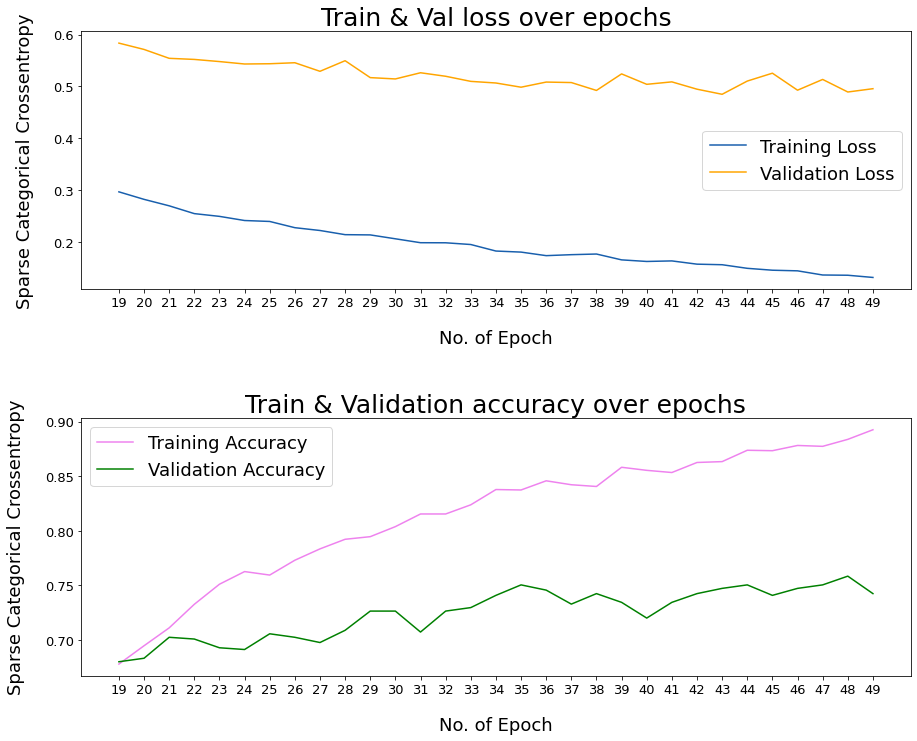

In [15]:
# Check train loss and test loss over epochs.
train_loss = history_v2_fine50.history['loss']
val_loss = history_v2_fine50.history['val_loss']
acc = history_v2_fine50.history['accuracy']
val_acc = history_v2_fine50.history['val_accuracy']
epochs_range = range(history_v2_fine50.epoch[0], history_v2_fine50.epoch[-1]+1)

# Set figure size.
plt.figure(figsize=(12, 10))
plt.subplots_adjust(left=0.01, right=0.97, top=0.96, bottom=0.065, hspace=0.5)

# Plot subplot for training, testing loss over epochs.
plt.subplot(2, 1, 1)
# 2 = 2 rows
# 1 = 1 column

plt.plot(epochs_range, train_loss, label='Training Loss', color='#185fad')
plt.plot(epochs_range, val_loss, label='Validation Loss', color='orange')
# Set title
plt.title('Train & Val loss over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18)
plt.xticks(ticks = list(range(history_v2_fine50.epoch[0], history_v2_fine50.epoch[-1]+1)), 
           labels = list(range(history_v2_fine50.epoch[0], history_v2_fine50.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)

# Plot subplot for training, testing accuracy over epochs.
plt.subplot(2, 1, 2)
# 2 = 2 rows
# 1 = 1 column
plt.plot(epochs_range, acc, label='Training Accuracy', color = 'violet')
plt.plot(epochs_range, val_acc, label='Validation Accuracy', color = 'green')
plt.legend(fontsize = 18)
# Set title
plt.title('Train & Validation accuracy over epochs', fontsize = 25)
plt.xlabel('No. of Epoch', fontsize = 18, labelpad=20)
plt.ylabel('Sparse Categorical Crossentropy', fontsize = 18, labelpad=20)
# set legend
plt.legend(fontsize = 18);
plt.xticks(ticks = list(range(history_v2_fine50.epoch[0], history_v2_fine50.epoch[-1]+1)), 
           labels = list(range(history_v2_fine50.epoch[0], history_v2_fine50.epoch[-1]+1)), fontsize = 13)
plt.yticks(fontsize = 13)
plt.show()

## Summary for evaluation of cnn model v2 with fine tuning of 55 top layers

In [16]:
# evaluate on training data to obtain base score for accuracy
model_v2_tune50.evaluate(train_ds)

79/79 [==============================] - 47s 582ms/step - loss: 0.3008 - accuracy: 0.8745


[0.3007766604423523, 0.8745003938674927]

In [17]:
# evaluate on validate data to obtain validate score for accuracy
model_v2_tune50.evaluate(val_ds)

20/20 [==============================] - 12s 567ms/step - loss: 0.4956 - accuracy: 0.7424


[0.4956248104572296, 0.7423999905586243]

In [22]:
# evaluate on unseen data
model_v2_tune50.evaluate(unseen_data)

4/4 [==============================] - 2s 355ms/step - loss: 0.3007 - accuracy: 0.8833


[0.30066317319869995, 0.8833333253860474]

In [23]:
# evaluate on test_ds data
model_v2_tune50.evaluate(test_ds)

25/25 [==============================] - 13s 484ms/step - loss: 0.4840 - accuracy: 0.7778


[0.4840230941772461, 0.7777777910232544]

## Look at the images model_v2 with fine tuning of 55 top layers has predicted correctly for different body parts in test_ds

In [156]:
# show the labels for the classes in test_ds
print(f' Class 0 is {test_ds.class_names[0]}.')
print(f' Class 1 is {test_ds.class_names[1]}.')

 Class 0 is Eczema.
 Class 1 is no eczema.


Predictions:
 [0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 1 0 1 1 1 0 0 0 0]
Labels:
 [0 0 1 0 1 0 0 1 0 0 1 1 0 0 0 1 0 1 1 0 0 0 0 1 1 0 1 0 1 1 0 1]


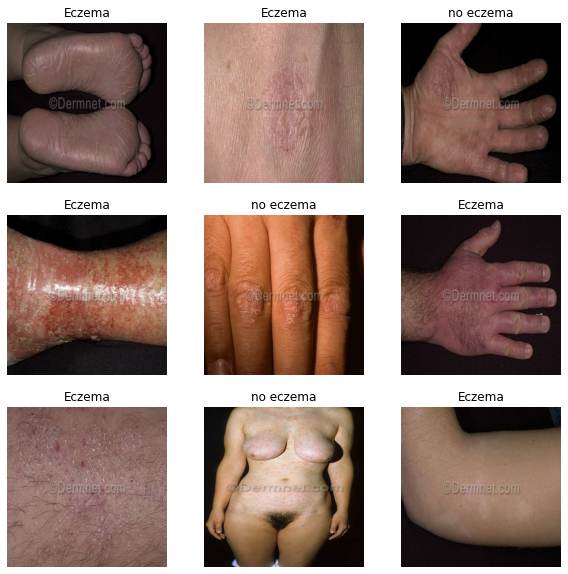

In [157]:
#Retrieve a batch of images from the unseen data
image, label = next(iter(test_ds))
predictions = model_v2_tune50.predict_on_batch(image)

# print  corresponding labels
print('Predictions:\n', np.argmax(predictions, axis=1))
print('Labels:\n', label.numpy())

# plot 9 pictures retrieved from 1 batch of 32 images
plt.figure(figsize=(10, 10))
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image[i].numpy().astype("uint8"))
    plt.title(test_ds.class_names[label[i]])      # shows correct label for corresponding image
    plt.axis("off")                               

**Accuracy scores for cnn model v2 with image pre-processing and dropout with fine tuning of 55 top layers** 

- train accuracy is 0.8745 (baseline)
- validate accuracy is 0.7424
- test accuracy for eczema in mixed body parts is 0.7778
- unseen_data (dataset consisting of eczema images from various body parts) accuracy is 0.8833
- the model is overfit, however the accuracy is modest when evaluated on test data

Overall, the accuracy of the model has increased after fine tuning 55 top layers of the base model compared to 25. There is an incremental increase of 5% in accuracy from 0.7313 to 0.7778.

# Visualize a layer in MobileV2Net to have a rough idea how the machine 'see' an image through different activated filters in the Conv2D layer

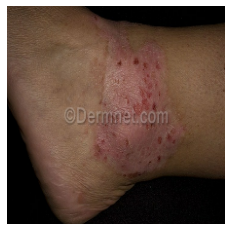

In [193]:
# Show original image
plt.imshow(image_batch[11].numpy().astype("uint8"))
plt.axis('off')
plt.show()

block_1_depthwise (1, 56, 56, 96) 


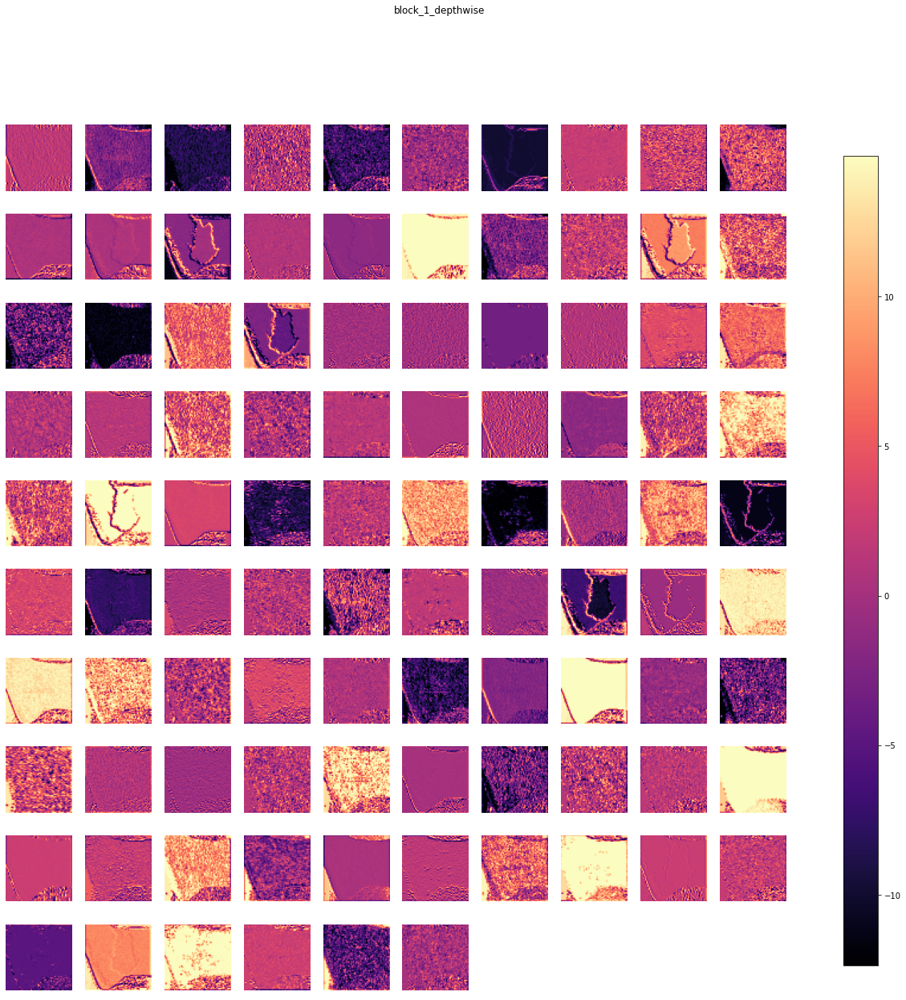

In [194]:
# use the keract library to visualize the output
test = tf.expand_dims(image_batch[11], 0)

activations = get_activations(v2_base_model, test, layer_names = 'block_1_depthwise')

display_activations(activations, fig_size=(20, 20), save=False, cmap = 'magma')

- From the activation of the layer `block_1_depthwise` in MobileNet V2, in some of the filters the inflamed area on the leg can be seen as an outstanding feature. From here, it is likely that the machine is able to learn what is an inflamed area in the body part.

# Summary of results of CNN models built


|Model|Number of Images used to train|Number of Images used to validate|Number of Images used to test|Train Accuracy|Validation Accuracy|Test Accuracy|
|---|---|---|---|---|---|---|
|Only feet, no pre-processing, no dropout|303|75|from unseen_data, 120|1.000|0.7467|0.5417|
|Only feet, with pre-processing, with dropout|303|75|from unseen_data, 120|0.7558|0.7733|0.5500|
|Various bodyparts, with pre-processing, no dropout|2502|625|from test_ds, 774|0.6059|0.5920|0.5943|
|Various bodyparts, with pre-processing, with MobileNet V2, with dropout|2502|625|from test_ds, 774|0.6807|0.6336|0.6882|
|Various bodyparts, with pre-processing, with MobileNet V2, with dropout, 25 top layers fine tuned|2502|625|from test_ds, 774|0.8125|0.7216|0.7313|
|Various bodyparts, with pre-processing, with MobileNet V2, with dropout, 55 top layers fine tuned|2502|625|from test_ds, 774|0.8745|0.7424|0.7778|

# Conclusion

- Through the approaches and workflow here, I was able to create a cnn model utilizing the MobileNetV2 as a base model to classify eczema and non-eczema images from various body parts with a modest accuracy of around 77%.
- If there are more images to train and validate the data in the cnn, it may have helped to improve the accuracy of the model.
- Future work can be done by introducing more classes into the project so that the model can classify for multiple skin diseases. After that, the model can be attempted to deploy on smartphones, as MobileNet is a deep learning model that is developed for efficiency and can  be implemented on embedded devices or mobile devices such as smartphones without compromising with resources.

https://www.researchgate.net/publication/343364827_Android_skin_cancer_detection_and_classification_based_on_MobileNet_v2_model